# Trabajo Final de Data Science 2024-2025:

El trabajo consiste en analizar un dataset libremente elegido por cada grupo, que constará de 2 alumnos.

El objetivo es que cada grupo sea capaz de llevar a cabo un análisis riguroso de los datos, así como de exponer y visualizar las conclusiones alcanzadas de forma convincente.

El trabajo puede llevarse a cabo tanto en R como en Python. Se entregará un ZIP file script con el código, datos necesarios y un informe del trabajo.

Se valorará los siguientes apartados:

1. Correcta definición del estudio que se quiere llevar a cabo, estableciendo claramente las preguntas que se pretender analizar en el estudio.

2. Uso adecuado de las distintas técnicas analíticas explicada durante el curso, incluyendo estadística inferencial y contraste de hipótesis, PCA, modelos de regresión lineal, incluyendo regularización, modelos de regresión logística, selección de variables, métodos de clustering.

3. Uso adecuado de técnicas de procesamiento de datos y visualización explicadas durante el curso.

4. Estilo adecuado y profesional en el informe entregado. Puede ser tanto en inglés como en castellano.

5. Presentación oral de los resultados del trabajo.  

Se adjunta un ejemplo de trabajo realizado el curso anterior. No es un trabajo perfecto. Tiene algunos fallos, particularmente se echan en falta un mejor uso de contraste de hipótesis para sustanciar los resultados e hipótesis generadas. Sin embargo, sirve como ejemplo para ver lo que se pide.

Fecha de Entrega: 06/11/2024

Fecha de Presentaciones: 12/11/2024, 15:00

## Datos:
(Jaime)
(explicación del dataset: columnas, tipos de datos, tamaño, fuente de los datos(link)...)

El dataset que se ha usado para este trabajo se ha obtenido de Kaggle. Con un tamaño de 371.03 kB y cuyo link es el siguiente: [https://www.kaggle.com/datasets/valakhorasani/electric-vehicle-charging-patterns](https://www.kaggle.com/datasets/valakhorasani/electric-vehicle-charging-patterns)


Este dataset proporciona un análisis exhaustivo de los patrones de carga de vehículos eléctricos (VE) y el comportamiento de los usuarios. Contiene 1,320 muestras de datos de sesiones de carga, incluyendo métricas como el consumo de energía, la duración de la carga y los detalles del vehículo. Cada entrada captura varios aspectos del uso de VE (20 columnas), permitiendo un análisis profundo y modelado predictivo.

Características Clave:

* ID de Usuario (**User ID**): Identificador único para cada usuario.
    - String

* Modelo del Vehículo (**Vehicle Model**): Modelo del vehículo eléctrico que se está cargando (por ejemplo, Tesla Model 3, Nissan Leaf). 
    - String

* Capacidad de Batería [kWh] (**Battery Capacity [kWh]**): Capacidad total de la batería del vehículo en kilovatios-hora. 
    - Float64
    - Rangos típicos: 30 - 100 kWh

* ID de la Estación de Carga (**Charging Station ID**): Identificador único para la estación de carga utilizada.
    - String

* Ubicación de la Estación de Carga (**Charging Station Location**): Ubicación geográfica de la estación de carga (por ejemplo, Nueva York, Los Ángeles).
    - String

* Hora de Inicio de la Carga (**Charging Start Time**): Marca temporal que indica cuándo comenzó la sesión de carga.
    - String

* Hora de Fin de la Carga (**Charging End Time**) : Marca temporal que indica cuándo terminó la sesión de carga.
    - String

* Energía Consumida [kWh] (**Energy Consumed [kWh]**): Energía total consumida durante la sesión de carga, medida en kilovatios-hora.
    - Float64
    - Rango típico: 5 - 90 kWh

* Duración de la Carga [horas] (**Charging Duration [hours]**): Tiempo total empleado para cargar el vehículo, medido en horas.
    - Float64
    - Rago típico: 0.5 - 12 horas

* Tasa de Carga [kW] (**Charging Rate [kW]**): Tasa promedio de entrega de energía durante la sesión de carga, medida en kilovatios.
    - Float64
    - Rango típico: 1-350 kW

* Costo de Carga [USD] (**Charging Cost [USD]**): Costo total incurrido por la sesión de carga, medido en dólares estadounidenses.
    - Float64

* Hora del Día (**Time of Day**): Segmento temporal cuando ocurrió la carga (por ejemplo, Mañana, Tarde).
    - String

* Día de la Semana (**Day of Week**): Día de la semana en que ocurrió la carga (por ejemplo, Lunes, Martes).
    - String

* Estado de Carga (Inicio %) (**State of Charge (Start %)**): Porcentaje de carga de la batería al inicio de la sesión de carga.
    - Float64

* Estado de Carga (Fin %) (**State of Charge (End %)**): Porcentaje de carga de la batería al final de la sesión de carga.
    - Float64

* Distancia Recorrida (desde la última carga) (km) (**Distance Driven (since last charge)(km)**): Distancia recorrida desde la última sesión de carga medida en kilómetros.
    - Float64
    - Rango típico: 0 - 500 Km

* Temperatura [°C] (**Temperature [°C]**): Temperatura ambiente durante la sesión de carga, medida en grados Celsius.
    - Float64

* Antigüedad del Vehículo [años] (**Vehicle Age [years]**): Edad del vehículo eléctrico, medida en años.
    - Float64

* Tipo de Cargador (**Charger Type**): Tipo de cargador utilizado (por ejemplo, Nivel 1, Nivel 2, Cargador Rápido DC).
    - String
    - Valores posibles:
        - Level 1:
        - Level 2:
        - DC Fast Charger:

* Tipo de Usuario (**User Type**): Clasificación del usuario según sus hábitos de conducción (por ejemplo, Commuter, Viajero de Larga Distancia).
    - String



## Metodología:

- Análisis del problema ¿Qué queremos?
- Visualización de los datos en crudo.
- Procesado de los datos.
- Representación de los datos y sus relaciones. (EDA)
- Contraste de hipotesis (Luis).
- Todo el tema de estadistica y machine learning.


# Importaciones para el proyecto:

In [42]:
import numpy as np
import pandas as pd
import pylab as pl
import matplotlib.pyplot as plt
import warnings


warnings.filterwarnings("ignore")




## Cargar los datos:

In [43]:
raw_data = pd.read_csv('DatasetDS/ev_charging_patterns.csv')
print(raw_data.head(5))
print(raw_data.describe())
print(f"Columnas numericas = {raw_data.describe().columns}")

  User ID Vehicle Model  Battery Capacity (kWh) Charging Station ID  \
0  User_1        BMW i3              108.463007         Station_391   
1  User_2  Hyundai Kona              100.000000         Station_428   
2  User_3    Chevy Bolt               75.000000         Station_181   
3  User_4  Hyundai Kona               50.000000         Station_327   
4  User_5  Hyundai Kona               50.000000         Station_108   

  Charging Station Location  Charging Start Time    Charging End Time  \
0                   Houston  2024-01-01 00:00:00  2024-01-01 00:39:00   
1             San Francisco  2024-01-01 01:00:00  2024-01-01 03:01:00   
2             San Francisco  2024-01-01 02:00:00  2024-01-01 04:48:00   
3                   Houston  2024-01-01 03:00:00  2024-01-01 06:42:00   
4               Los Angeles  2024-01-01 04:00:00  2024-01-01 05:46:00   

   Energy Consumed (kWh)  Charging Duration (hours)  Charging Rate (kW)  \
0              60.712346                   0.591363        

Como se puede ver en el resultado de .describe, en algunas columnas faltan datos. Estas columnas son "Energy Consumed (kWh)", "Charging Rate (kW)","Distance Driven (since last charge) (km)". De las cuales faltan exáctamente 66 datos en cada una de las columnas, de forma aleatoria, es decir, no coinciden las filas con las columnas de los otros datos que faltan.

Para solucionar el tema de los datos faltantes rellenaremos dichos campos con la mediana.

Además aplicaremos un redondeo a algunas de las columnas, porque hay en dichas columnas muchos datos enteros y algún que otro dato con muchos decimales. Lo que significa que lo sdatos enteros han sido introducidos sin ser estas medidas precisas.

## Feature Engineering:

In [44]:
# Llenar valores NaN con la mediana para columnas seleccionadas
for column in ['Battery Capacity (kWh)', 'Energy Consumed (kWh)', 'Charging Duration (hours)', 
               'Charging Rate (kW)', 'Charging Cost (USD)', 'State of Charge (Start %)', 
               'State of Charge (End %)', 'Distance Driven (since last charge) (km)', 
               'Temperature (°C)', 'Vehicle Age (years)']:
    raw_data[column].fillna(raw_data[column].median(), inplace=True)

# Redondear valores de Battery Capacity y Vehicle Age a 0 decimales
raw_data['Battery Capacity (kWh)'] = raw_data['Battery Capacity (kWh)'].round(0)
raw_data['Vehicle Age (years)'] = raw_data['Vehicle Age (years)'].round(0)

# Crear la columna 'Percentage of Charge'
#raw_data['Percentage of Charge'] = raw_data['State of Charge (End %)'] - raw_data['State of Charge (Start %)']

# Añadir nuevas características al dataset
raw_data['Charging Efficiency (kWh/h)'] = raw_data['Energy Consumed (kWh)'] / raw_data['Charging Duration (hours)']
raw_data['Energy per Charge %'] = raw_data['Energy Consumed (kWh)'] / (raw_data['State of Charge (End %)'] - raw_data['State of Charge (Start %)'])
raw_data['Distance per kWh'] = raw_data['Distance Driven (since last charge) (km)'] / raw_data['Energy Consumed (kWh)']
raw_data['Total Charge Gained'] = raw_data['State of Charge (End %)'] - raw_data['State of Charge (Start %)']
raw_data['Charger Efficiency'] = raw_data['Charging Rate (kW)'] / raw_data['Charging Duration (hours)']
raw_data['Charge Rate (%/h)'] = raw_data['Total Charge Gained'] / raw_data['Charging Duration (hours)']


# Manejo de divisiones por cero o valores infinitos
raw_data.replace([np.inf, -np.inf], np.nan, inplace=True)
raw_data.fillna(0, inplace=True)  # Reemplaza NaN o infinito con 0 para simplificar

# Ajuste de consumo de energía basado en temperatura, asumiendo 20°C como temperatura "promedio" cómoda para los vehículos eléctricos
average_temperature = 20
raw_data['Temperature Adjusted Consumption'] = raw_data['Energy Consumed (kWh)'] * \
                                                 (1 + abs(raw_data['Temperature (°C)'] - average_temperature) / average_temperature)

# Verificar nuevas características
raw_data.head()


,User ID,Vehicle Model,Battery Capacity (kWh),Charging Station ID,Charging Station Location,Charging Start Time,Charging End Time,Energy Consumed (kWh),Charging Duration (hours),Charging Rate (kW),...,Vehicle Age (years),Charger Type,User Type,Charging Efficiency (kWh/h),Energy per Charge %,Distance per kWh,Total Charge Gained,Charger Efficiency,Charge Rate (%/h),Temperature Adjusted Consumption
0,User_1,BMW i3,108.0,Station_391,Houston,2024-01-01 00:00:00,2024-01-01 00:39:00,60.712346,0.591363,36.389181,...,2.0,DC Fast Charger,Commuter,102.665033,1.069851,4.835954,56.748386,61.534378,95.961948,84.839289
1,User_2,Hyundai Kona,100.0,Station_428,San Francisco,2024-01-01 01:00:00,2024-01-01 03:01:00,12.339275,3.133652,30.677735,...,3.0,Level 1,Casual Driver,3.937666,0.165520,9.085850,74.548566,9.789771,23.789676,15.849166
2,User_3,Chevy Bolt,75.0,Station_181,San Francisco,2024-01-01 02:00:00,2024-01-01 04:48:00,19.128876,2.452653,27.513593,...,2.0,Level 2,Commuter,7.799260,0.303330,3.753449,63.063011,11.217892,25.712165,20.087234
3,User_4,Hyundai Kona,50.0,Station_327,Houston,2024-01-01 03:00:00,2024-01-01 06:42:00,79.457824,1.266431,32.882870,...,1.0,Level 1,Long-Distance Traveler,62.741544,4.814364,2.511745,16.504325,25.964995,13.032157,152.226543
4,User_5,Hyundai Kona,50.0,Station_108,Los Angeles,2024-01-01 04:00:00,2024-01-01 05:46:00,19.629104,2.019765,10.215712,...,1.0,Level 1,Long-Distance Traveler,9.718509,2.069525,10.375504,9.484836,5.057871,4.696010,46.947124


1. ***Charging Efficiency (kWh/h)***: Calcula la cantidad de energía suministrada por hora, lo que indica la eficiencia de la carga en función del tiempo. Es útil para ver qué tan rápido un cargador carga una batería específica, proporcionando una medida directa de rendimiento que puede ser más informativa que el simple "Charging Rate".

  $$ \text{Charging Efficiency (kWh/h)} = \frac{\text{Energy Consumed (kWh)}}{\text{Charging Duration (hours)}} $$

- Rango típico: 1 - 250 kWh/h

2. ***Energy per Charge %***: Relaciona la energía consumida con el porcentaje de carga. Esto permite ver cuánta energía se usa para aumentar el SoC (State of Charge) en una unidad porcentual, lo que ayuda a evaluar la eficiencia energética y a identificar posibles pérdidas.

  $$ \text{Energy per Charge \%} = \frac{\text{Energy Consumed (kWh)}}{\text{State of Charge (End \%)} - \text{State of Charge (Start \%)}} $$

- Rango típico: 0 - 1 

3. ***Distance per kWh***: Mide la distancia recorrida por cada kWh, lo cual es fundamental para analizar la eficiencia del vehículo. Esta característica puede ayudar a modelar el impacto de la distancia en el consumo de energía, proporcionando información sobre el rendimiento del vehículo.

  $$ \text{Distance per kWh} = \frac{\text{Distance Driven (since last charge) (km)}}{\text{Energy Consumed (kWh)}} $$

- Rango típico: 0 - 9 km/kWh

4. ***Total Charge Gained***: Indica el incremento total en el SoC durante una sesión de carga. Es relevante para ver cuánta carga neta se añade a la batería, proporcionando un resumen que puede estar correlacionado con el tiempo y la energía consumida.

  $$ \text{Total Charge Gained} = \text{State of Charge (End \%)} - \text{State of Charge (Start \%)} $$

- Rango típico: 0 - 100 %

5. ***Charger Efficiency***: Compara la tasa de carga con la energía que realmente se convierte en carga de la batería. Esto permite evaluar la eficiencia real de cada tipo de cargador y podría ser útil para seleccionar estaciones de carga óptimas.

  $$ \text{Charger Efficiency} = \frac{\text{Charging Rate (kW)}}{\text{Charging Duration (hours)}} $$

- Rango típico: 1 - 350 kW

6. ***Temperature Adjusted Consumption***: Ajusta el consumo de energía en función de la temperatura, teniendo en cuenta que el clima afecta el rendimiento de la batería. Esta característica ayuda a incorporar los efectos de las condiciones ambientales, mejorando el ajuste del modelo en escenarios variados.

  $$ \text{Temperature Adjusted Consumption} = \text{Energy Consumed (kWh)} \times \left(1 + \frac{|\text{Temperature (°C)} - \text{average temperature}|}{\text{average temperature}}\right)
  $$

- Rango típico: 0 - 9 km/kWh

7. ***Charge Rate (%/h)***: Porcentaje de la batería que se carga por hora.

  $$ \text{Charge Rate} = \frac{\text{Total Charge Gained}}{\text{Charging Duration (hours)}} $$

- Rango típico: 2 - 80 %/h

## Feature Selection:

In [45]:
# Eliminar columnas irrelevantes para análisis
data_cleaned = raw_data.drop(columns=['User ID', 'Charging Station ID', 'Charging Start Time', 
                                      'Charging End Time', 'State of Charge (Start %)', 'State of Charge (End %)', 'User Type', 'Day of Week', 'Time of Day'])

# Cambiar el nombre de una columna para mayor claridad
data_cleaned.rename(columns={'Distance Driven (since last charge) (km)': 'Distance Driven(km)'}, inplace=True)

# Verificación para comprobar que no hay NaN values
print(data_cleaned.isna().sum())

# Verifica los cambios en las columnas
#print(data_cleaned[['Battery Capacity (kWh)', 'Vehicle Age (years)']].head())


# Filtrar filas donde 'Total Charge Gained' esté entre 0 y 100
print(f"Valores eliminados por la condición de Total Charge Gained entre 0 y 100 : {len(data_cleaned[~(raw_data['Total Charge Gained'] >= 0) & (raw_data['Total Charge Gained'] <= 100)])} filas")
data_cleaned = data_cleaned[(raw_data['Total Charge Gained'] >= 0) & (raw_data['Total Charge Gained'] <= 100)]

print(f"Valores eliminados por la condición de Charge Rate (% per hour)' <= 160 : {len(data_cleaned[~(raw_data['Charge Rate (%/h)'] <= 160)])} filas")
data_cleaned = data_cleaned[raw_data['Charge Rate (%/h)'] <= 160]

print(f"Valores eliminados por la condición de Charging Efficiency (kWh/h) >= 1 : {len(data_cleaned[~(raw_data['Charging Efficiency (kWh/h)'] > 1)])} filas")
data_cleaned = data_cleaned[raw_data['Charging Efficiency (kWh/h)'] >= 1]

print(f"Valores eliminados por la condición de Total battery capacity entre 30 y 100 : {len(data_cleaned[~((raw_data['Battery Capacity (kWh)'] >= 30) & (raw_data['Battery Capacity (kWh)'] <= 100))])} filas")
data_cleaned = data_cleaned[(raw_data['Battery Capacity (kWh)'] >= 30) & (raw_data['Battery Capacity (kWh)'] <= 100)]

# Temperaturas: 
ciudades_temp_max = {
    "Houston": 24,
    "Los Angeles": 27,
    "New York": 20,
    "San Francisco": 27,
    "Chicago": 22
}

# Iterar sobre cada ciudad y aplicar el filtro correspondiente
for ciudad, temp_max in ciudades_temp_max.items():
    # Contar las filas eliminadas antes de aplicar el filtro
    filas_eliminadas = len(data_cleaned[~((data_cleaned['Charging Station Location'] != ciudad) | ((data_cleaned['Charging Station Location'] == ciudad)  & (raw_data['Temperature (°C)'] <= temp_max)))])
    print(f"Valores eliminados por la condición en {ciudad} con Temp <= {temp_max}°C: {filas_eliminadas} filas")
    # Aplicar el filtro
    data_cleaned = data_cleaned[((data_cleaned['Charging Station Location'] != ciudad) | ((data_cleaned['Charging Station Location'] == ciudad) & (raw_data['Temperature (°C)'] <= temp_max)))]

# Mostrar el DataFrame resultante
data_cleaned


Vehicle Model                       0
Battery Capacity (kWh)              0
Charging Station Location           0
Energy Consumed (kWh)               0
Charging Duration (hours)           0
Charging Rate (kW)                  0
Charging Cost (USD)                 0
Distance Driven(km)                 0
Temperature (°C)                    0
Vehicle Age (years)                 0
Charger Type                        0
Charging Efficiency (kWh/h)         0
Energy per Charge %                 0
Distance per kWh                    0
Total Charge Gained                 0
Charger Efficiency                  0
Charge Rate (%/h)                   0
Temperature Adjusted Consumption    0
dtype: int64
Valores eliminados por la condición de Total Charge Gained entre 0 y 100 : 268 filas
Valores eliminados por la condición de Charge Rate (% per hour)' <= 160 : 3 filas
Valores eliminados por la condición de Charging Efficiency (kWh/h) >= 1 : 3 filas
Valores eliminados por la condición de Total battery c

,Vehicle Model,Battery Capacity (kWh),Charging Station Location,Energy Consumed (kWh),Charging Duration (hours),Charging Rate (kW),Charging Cost (USD),Distance Driven(km),Temperature (°C),Vehicle Age (years),Charger Type,Charging Efficiency (kWh/h),Energy per Charge %,Distance per kWh,Total Charge Gained,Charger Efficiency,Charge Rate (%/h),Temperature Adjusted Consumption
1,Hyundai Kona,100.0,San Francisco,12.339275,3.133652,30.677735,21.128448,112.112804,14.311026,3.0,Level 1,3.937666,0.165520,9.085850,74.548566,9.789771,23.789676,15.849166
2,Chevy Bolt,75.0,San Francisco,19.128876,2.452653,27.513593,35.667270,71.799253,21.002002,2.0,Level 2,7.799260,0.303330,3.753449,63.063011,11.217892,25.712165,20.087234
4,Hyundai Kona,50.0,Los Angeles,19.629104,2.019765,10.215712,10.161471,203.661847,-7.834199,1.0,Level 1,9.718509,2.069525,10.375504,9.484836,5.057871,4.696010,46.947124
7,Chevy Bolt,75.0,Los Angeles,51.467617,2.655396,26.702908,9.796821,116.543166,-4.417460,0.0,Level 2,19.382272,6.785347,2.264398,7.585112,10.056091,2.856490,114.303040
8,Chevy Bolt,62.0,Los Angeles,43.592372,1.724204,14.294923,32.465005,208.259742,22.516706,4.0,Level 1,25.282613,0.732704,4.777435,59.495221,8.290740,34.505914,49.077832
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1306,BMW i3,75.0,San Francisco,54.825113,0.557213,45.863832,22.930048,69.728623,23.601370,5.0,Level 1,98.391604,2.150850,1.271837,25.489975,82.309287,45.745451,64.697389
1308,BMW i3,75.0,Los Angeles,6.432324,0.930239,9.025939,16.431101,209.983564,21.696951,2.0,DC Fast Charger,6.914698,3.587888,32.645053,1.792788,9.702814,1.927233,6.978091
1311,Hyundai Kona,50.0,Houston,74.276701,2.849151,25.073544,38.194006,194.793544,7.731967,3.0,Level 2,26.069762,8.190826,2.622539,9.068280,8.800355,3.182800,119.838150
1314,Hyundai Kona,50.0,New York,43.251453,2.501809,63.216118,36.356930,220.281863,1.630850,5.0,Level 1,17.288073,13.996224,5.093051,3.090223,25.268166,1.235196,82.976076


In [46]:
data_cleaned.describe()

,Battery Capacity (kWh),Energy Consumed (kWh),Charging Duration (hours),Charging Rate (kW),Charging Cost (USD),Distance Driven(km),Temperature (°C),Vehicle Age (years),Charging Efficiency (kWh/h),Energy per Charge %,Distance per kWh,Total Charge Gained,Charger Efficiency,Charge Rate (%/h),Temperature Adjusted Consumption
count,675.000000,675.000000,675.000000,675.000000,675.000000,675.000000,675.000000,675.000000,675.000000,675.000000,675.000000,675.000000,675.000000,675.000000,675.000000
mean,74.728889,43.839426,2.298319,25.806204,22.382646,155.675587,6.938476,3.681481,25.908768,3.222906,5.598145,35.657678,15.154614,20.564122,73.316619
std,17.616226,21.528464,1.044475,13.679103,10.651294,85.086727,9.778602,2.299696,24.664552,9.250540,6.506823,21.848411,13.730199,20.068532,40.906481
min,30.000000,1.754520,0.154301,1.472549,0.307085,0.862361,-9.831678,0.000000,1.320665,0.033838,0.020200,0.423036,0.685389,0.197560,2.275269
25%,62.000000,26.799715,1.400850,14.232373,13.133925,84.515707,-1.460592,2.000000,11.185393,0.760552,1.797159,17.894930,5.937579,7.568519,42.258364
50%,75.000000,42.691405,2.311637,25.603799,21.663313,152.259867,6.362088,4.000000,19.382272,1.253416,3.560389,33.480705,10.999717,15.179503,69.783056
75%,85.000000,61.599199,3.134594,36.847250,31.675804,230.994536,15.275256,6.000000,30.161359,2.602607,6.732511,52.887639,19.322440,25.751724,98.890473
max,100.000000,127.757474,6.773095,71.621041,60.402525,369.853524,26.616978,11.000000,227.849779,135.920128,47.880184,96.666262,114.321882,138.869139,233.204979


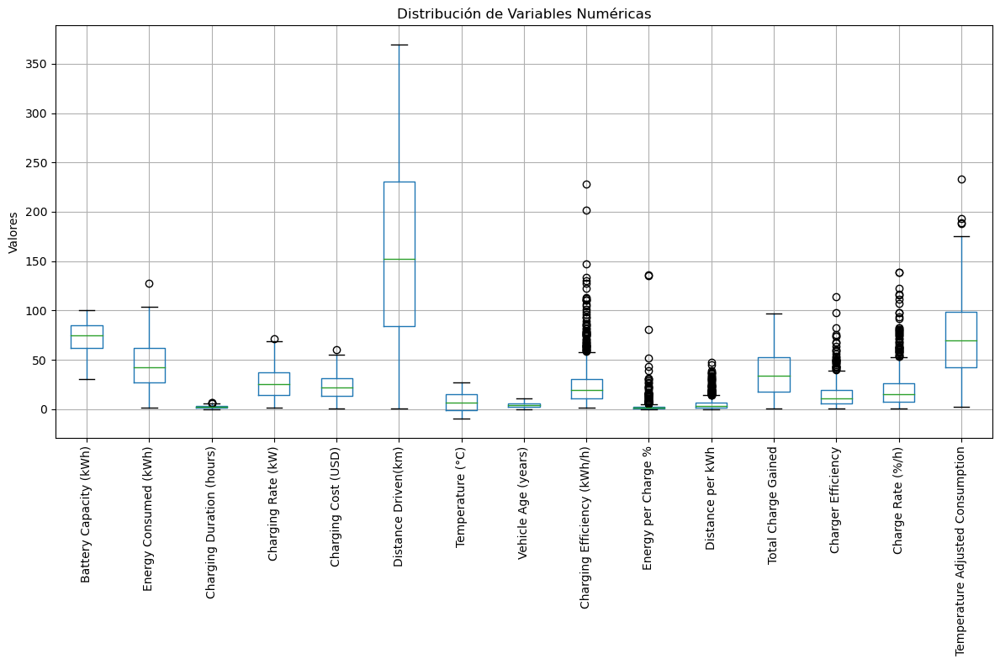

In [47]:
numeric_columns = data_cleaned.describe().columns  # Seleccionar las columnas numéricas a partir de describe()

# Generar el gráfico de boxplot
plt.figure(figsize=(12, 8))
data_cleaned[numeric_columns].boxplot()
plt.title("Distribución de Variables Numéricas")
plt.xticks(rotation=90)
plt.ylabel("Valores")
plt.grid(True)
plt.tight_layout()
plt.show()

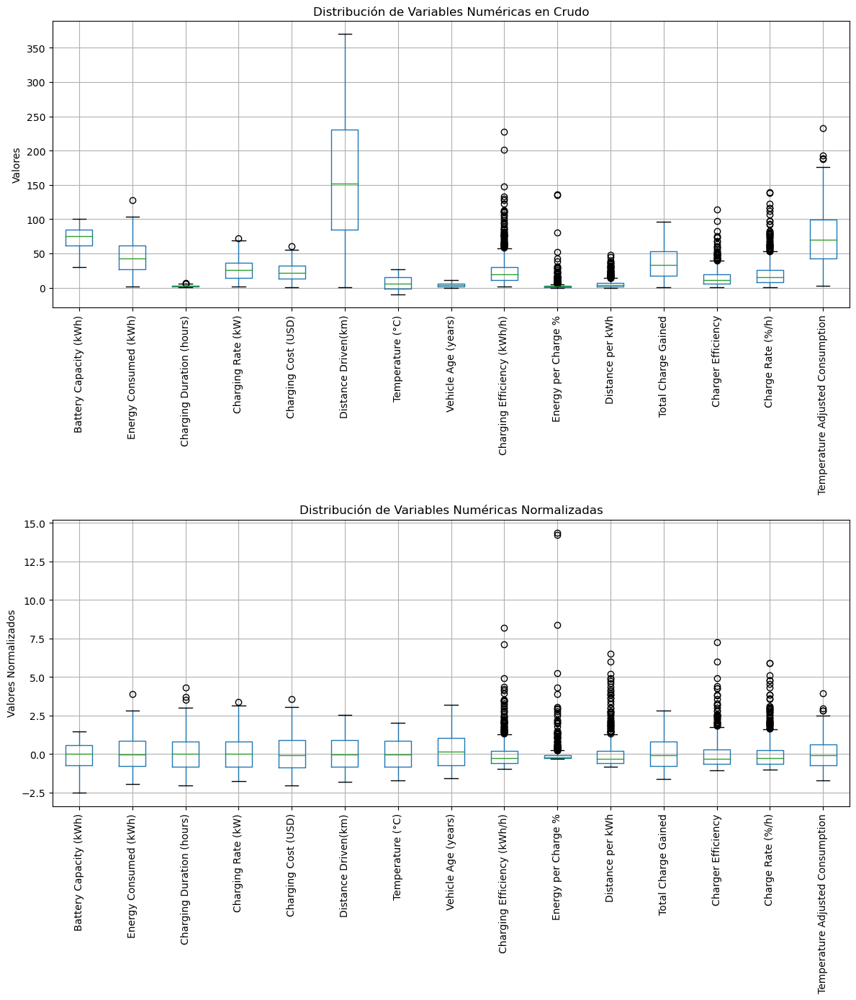

In [48]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler

# Normalizar los datos
scaler = StandardScaler()
data_normalized = pd.DataFrame(scaler.fit_transform(data_cleaned[numeric_columns]), columns=numeric_columns)

# Crear subplots
fig, axs = plt.subplots(2, 1, figsize=(12, 14))

# Gráfico boxplot con datos en crudo
data_cleaned[numeric_columns].boxplot(ax=axs[0])
axs[0].set_title("Distribución de Variables Numéricas en Crudo")
axs[0].set_xticklabels(numeric_columns, rotation=90)
axs[0].set_ylabel("Valores")
axs[0].grid(True)
#axs[0].set_ylim(-200, 800)

# Gráfico boxplot con datos normalizados
data_normalized.boxplot(ax=axs[1])
axs[1].set_title("Distribución de Variables Numéricas Normalizadas")
axs[1].set_xticklabels(numeric_columns, rotation=90)
axs[1].set_ylabel("Valores Normalizados")
axs[1].grid(True)
#axs[1].set_ylim(-10, 10) #Se han cortado muchos outliers 

# Ajustar el layout
plt.tight_layout()
plt.show()

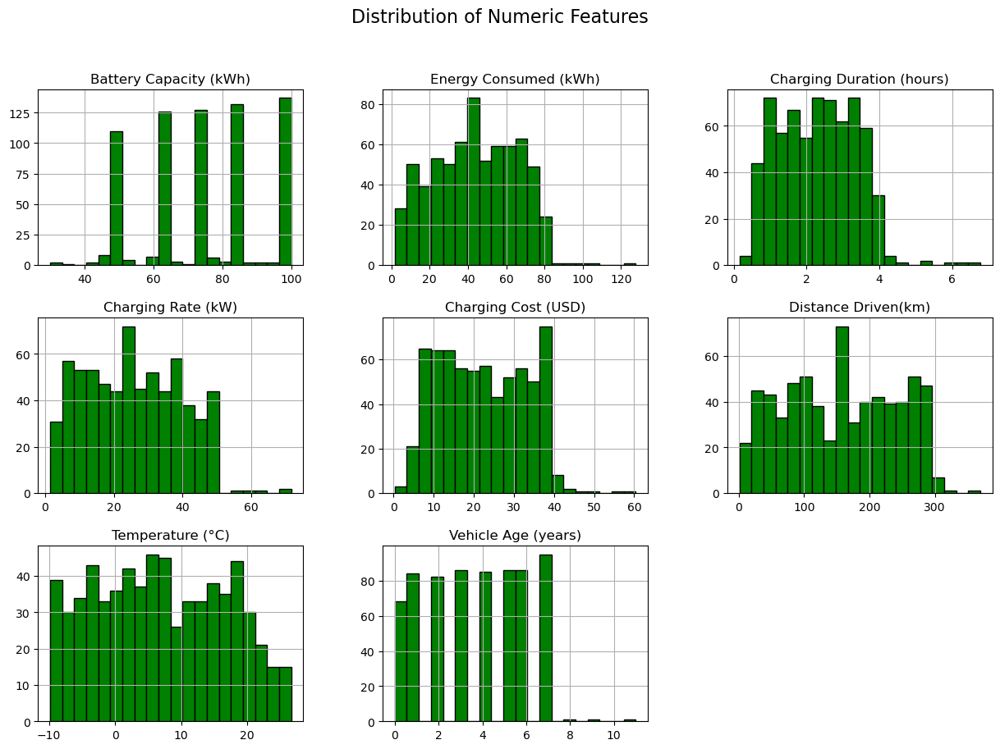

In [49]:
# Visualizar la distribución de las variables antiguas
old_features = ['Battery Capacity (kWh)', 'Energy Consumed (kWh)', 'Charging Duration (hours)',
                'Charging Rate (kW)', 'Charging Cost (USD)', 'Distance Driven(km)',
                'Temperature (°C)', 'Vehicle Age (years)']

# Graficar histogramas para las variables antiguas
data_cleaned[old_features].hist(bins=20, figsize=(15, 10), color='Green', edgecolor='black')
plt.suptitle('Distribution of Numeric Features', fontsize=16)
plt.show()

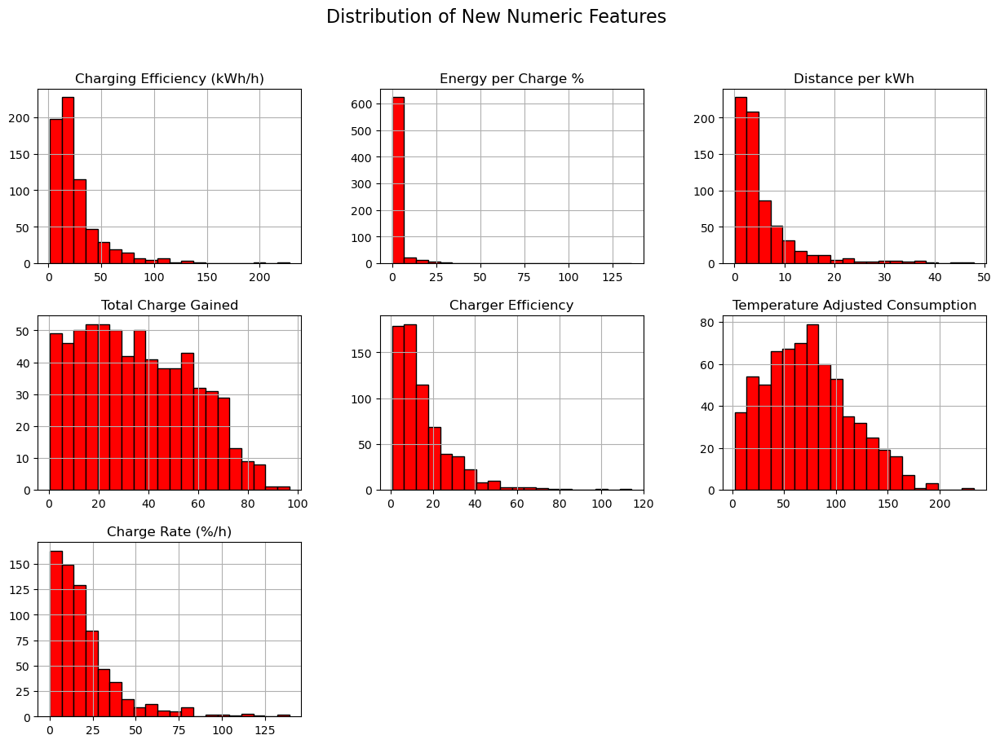

In [50]:
import matplotlib.pyplot as plt

# Visualize the distribution of new features
new_features = ['Charging Efficiency (kWh/h)', 'Energy per Charge %',
                'Distance per kWh', 'Total Charge Gained',
                'Charger Efficiency', 'Temperature Adjusted Consumption', 'Charge Rate (%/h)']

# Plot histograms for new features
data_cleaned[new_features].hist(bins=20, figsize=(15,10), color='red', edgecolor='black')
plt.suptitle('Distribution of New Numeric Features', fontsize=16)
plt.show()

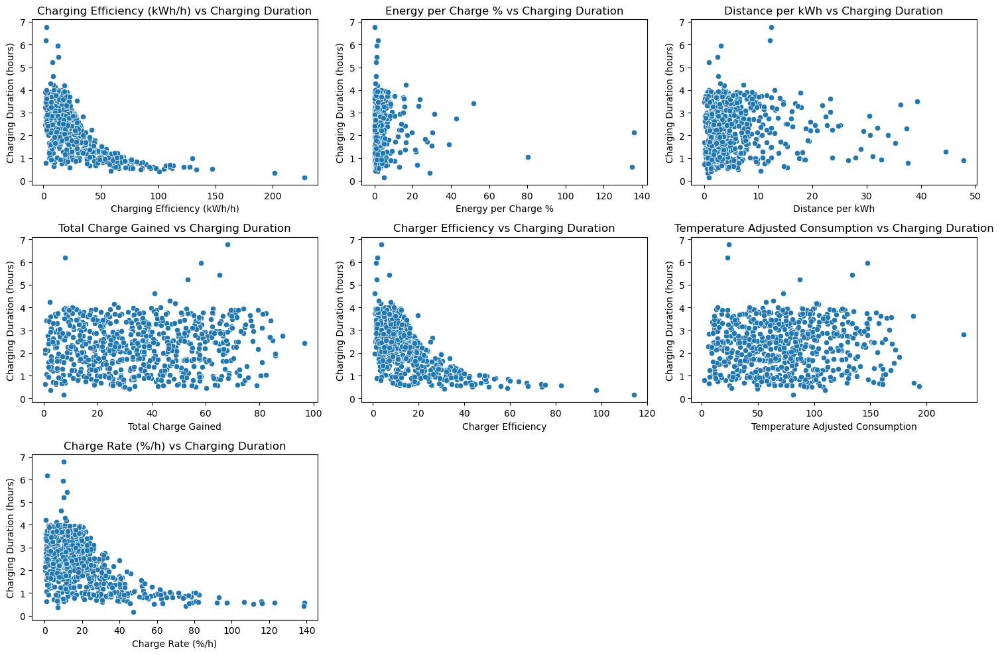

In [51]:
import seaborn as sns


plt.figure(figsize=(15,10))

for i, feature in enumerate(new_features, 1):
    plt.subplot(3, 3, i)
    sns.scatterplot(x=data_cleaned[feature], y=raw_data['Charging Duration (hours)'])
    plt.title(f'{feature} vs Charging Duration', fontsize=12)
    plt.xlabel(feature)
    plt.ylabel('Charging Duration (hours)')

plt.tight_layout()
plt.show()

## EDA:

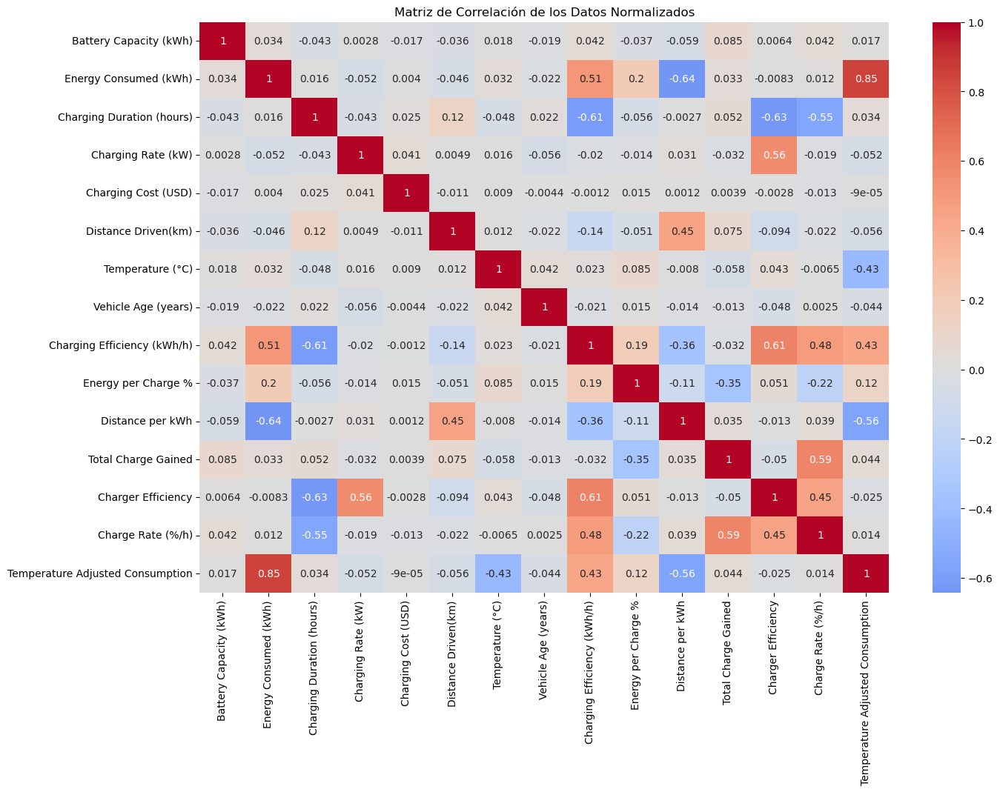

In [52]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler


# Filtrar solo las columnas numéricas
numerical_data = data_cleaned.select_dtypes(include=['float64', 'int64'])

# Normalizar los datos (usando StandardScaler para estandarización)
scaler = StandardScaler()
numerical_data_normalized = scaler.fit_transform(numerical_data)

# Crear un DataFrame de los datos normalizados, usando los mismos nombres de columnas
numerical_data_normalized = pd.DataFrame(numerical_data_normalized, columns=numerical_data.columns)

# Calcular la matriz de correlación
correlation_matrix = numerical_data_normalized.corr()

# Visualizar la matriz de correlación
plt.figure(figsize=(15, 10))
sns.heatmap(correlation_matrix, annot=True, cmap="coolwarm", center=0)
plt.title("Matriz de Correlación de los Datos Normalizados")
plt.show()


<Figure size 1200x1200 with 0 Axes>

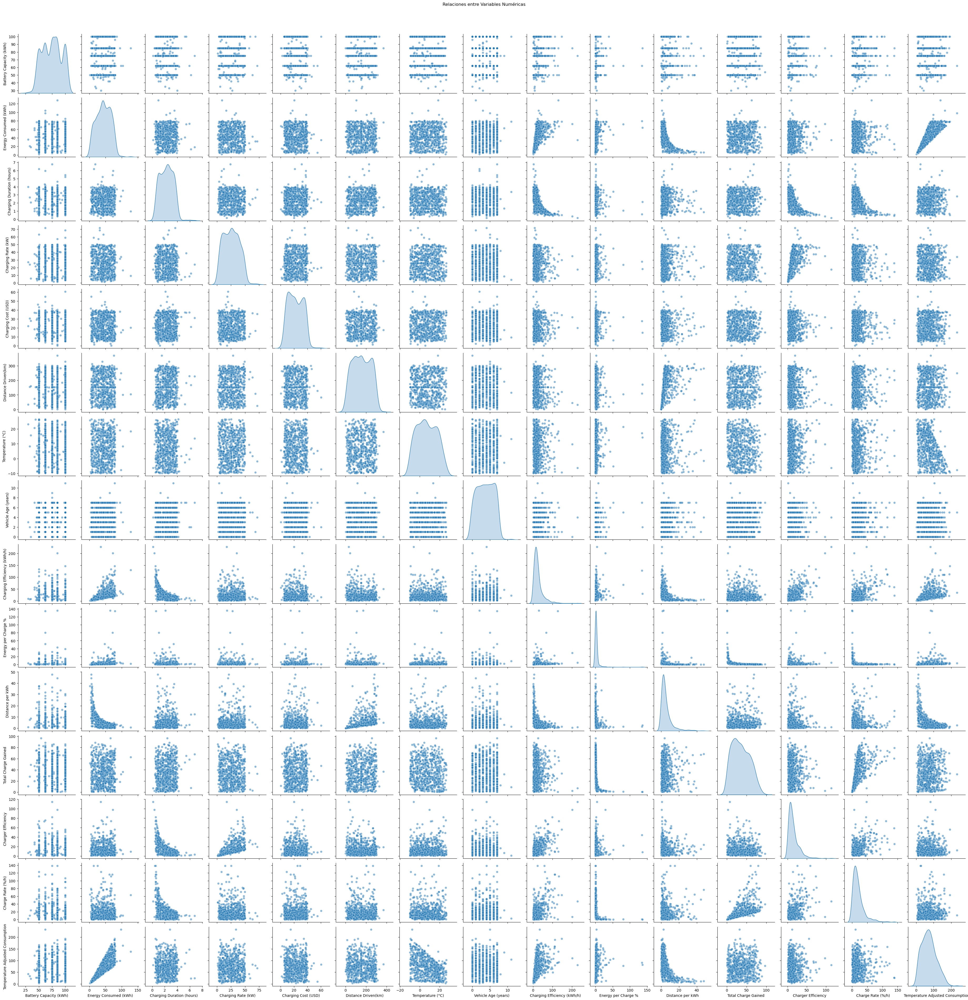

In [53]:
import seaborn as sns
import matplotlib.pyplot as plt

# Crear un gráfico de pares para todas las variables numéricas
plt.figure(figsize=(12, 12))
sns.pairplot(data_cleaned, diag_kind='kde', plot_kws={'alpha': 0.5})

plt.suptitle("Relaciones entre Variables Numéricas", y=1.02)
plt.show()


## Contraste de hipótesis

### Experimento 1

Este experimento busca entender si el **costo de carga** varía significativamente entre distintas **ubicaciones de estaciones**. Determinar esto puede ayudar a mejorar la planificación de costos y ofrecer información útil tanto para usuarios de vehículos eléctricos como para operadores de estaciones de carga.


In [54]:
from scipy.stats import f_oneway

# Filtrar datos necesarios para el ANOVA
# Agrupar los datos de "Charging Cost (USD)" por "Charging Station Location"
anova_data = data_cleaned[['Charging Station Location', 'Charging Cost (USD)']].dropna()

# Extraer los costos por cada ubicación única
station_groups = [anova_data['Charging Cost (USD)'][anova_data['Charging Station Location'] == location] 
                  for location in anova_data['Charging Station Location'].unique()]

# Realizar el test ANOVA
anova_result = f_oneway(*station_groups)
anova_result


F_onewayResult(statistic=0.3859208050504215, pvalue=0.8187829885870216)


**Resultados del ANOVA:**
- **Estadístico F**: 0.386
- **Valor p**: 0.819

**Interpretación:**
- El **estadístico F** bajo (0.386) indica que la variación en el costo de carga **entre las distintas ubicaciones** es pequeña en comparación con la variación dentro de cada ubicación.
- El **valor p** (0.819) es mayor que el umbral común de significancia (0.05), lo que significa que **no hay evidencia estadísticamente significativa** para rechazar la hipótesis nula.

**Conclusión:**
Estos resultados sugieren que **no existen diferencias significativas** en el costo de carga entre las ubicaciones de las estaciones en este dataset. Por lo tanto, la ubicación de la estación **no afecta significativamente** el costo promedio de carga en este análisis.


### Experimento 2
Este experimento analiza si el **tiempo de carga** difiere significativamente según el **tipo de cargador** (DC Fast Charger, Level 1, Level 2). Determinar estas diferencias puede ser útil para entender la eficiencia relativa de cada tipo de cargador y ayudar a los usuarios a elegir el más adecuado para sus necesidades de carga.


In [55]:
from scipy.stats import f_oneway

# Agrupar los datos de tiempos de carga por tipo de cargador
dc_fast = data_cleaned[data_cleaned['Charger Type'] == 'DC Fast Charger']['Charging Duration (hours)'].dropna()
level_1 = data_cleaned[data_cleaned['Charger Type'] == 'Level 1']['Charging Duration (hours)'].dropna()
level_2 = data_cleaned[data_cleaned['Charger Type'] == 'Level 2']['Charging Duration (hours)'].dropna()

# Realizar el test ANOVA
anova_result = f_oneway(dc_fast, level_1, level_2)
print("Estadístico F:", anova_result.statistic)
print("Valor p:", anova_result.pvalue)

Estadístico F: 0.4981116205115907
Valor p: 0.6079012876815124


**Resultados del ANOVA**:
- **Estadístico F**: 0.498
- **Valor p**: 0.608

**Interpretación:**
- El **estadístico F** bajo (0.498) indica que la variación en el tiempo de carga **entre los distintos tipos de cargador** es pequeña en comparación con la variación dentro de cada tipo.
- El **valor p** (0.608) es mayor que el umbral común de significancia (0.05), lo que significa que **no hay evidencia estadísticamente significativa** para rechazar la hipótesis nula.

**Conclusión:**
Estos resultados sugieren que **no existen diferencias significativas** en el tiempo de carga entre los tipos de cargador en este dataset. Por lo tanto, el tipo de cargador **no afecta significativamente** la duración promedio de carga en este análisis.


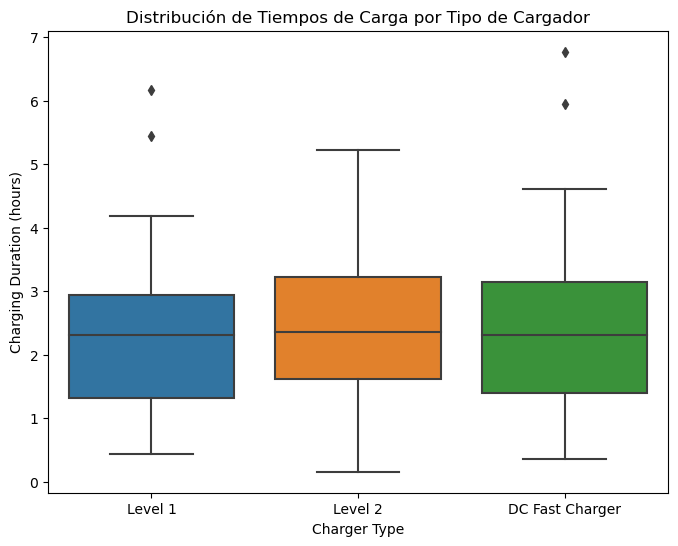

In [56]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(8, 6))
sns.boxplot(x='Charger Type', y='Charging Duration (hours)', data=data_cleaned)
plt.title("Distribución de Tiempos de Carga por Tipo de Cargador")
plt.show()


Comprobamos lo evaluado en el experimento observando que las medias son muy parecidas en los boxplots por cada tipo de cargador.

In [57]:
from scipy.stats import kruskal

kruskal_result = kruskal(dc_fast, level_1, level_2)
print("Estadístico Kruskal-Wallis:", kruskal_result.statistic)
print("Valor p:", kruskal_result.pvalue)


Estadístico Kruskal-Wallis: 1.3514194705617228
Valor p: 0.5087951825392316


### Experimento 3

Este experimento examina si existe una relación inversa entre la **Tasa de Carga** (`Charging Rate (kW)`) y el **Tiempo de Carga**. Identificar esta relación puede confirmar la eficiencia de cargadores rápidos y ayudar a optimizar la infraestructura de carga para reducir tiempos de espera.


In [58]:
from scipy.stats import pearsonr

# Filtrar los datos para calcular la correlación
correlation_data = data_cleaned[['Charging Rate (kW)', 'Charging Duration (hours)']].dropna()

# Calcular la correlación de Pearson
correlation_result, p_value = pearsonr(correlation_data['Charging Rate (kW)'], correlation_data['Charging Duration (hours)'])
print("Correlación de Pearson:", correlation_result)
print("Valor p:", p_value)


Correlación de Pearson: -0.04325533974586784
Valor p: 0.2617565482900129


**Resultados:**
- **Correlación de Pearson**: -0.043
- **Valor p**: 0.262

**Interpretación:**
- La **Correlación de Pearson** (-0.043) es muy cercana a 0, lo que indica que **no existe una relación lineal significativa** entre la tasa de carga y el tiempo de carga.
- El **valor p** (0.262) es superior a 0.05, lo que confirma la falta de una relación estadísticamente significativa entre estas dos variables.

**Conclusión:**
Estos resultados sugieren que la **Tasa de Carga** no tiene un efecto directo en la duración de la carga en este análisis.


### Experimento 4

Este análisis busca identificar qué variables numéricas tienen un **impacto estadísticamente significativo** en el **Tiempo de Carga** (`Charging Duration (hours)`). Comprender qué factores afectan la duración de carga es crucial para optimizar los tiempos de espera en estaciones de carga y mejorar la eficiencia del sistema de carga en vehículos eléctricos. Identificar estas variables también proporciona información valiosa para fabricantes y operadores, ayudándoles a tomar decisiones fundamentadas en el diseño y la gestión de la infraestructura de carga.

In [59]:
from scipy.stats import ttest_ind
import pandas as pd

# Lista para almacenar los resultados
p_values = {}
significant_vars = []

# Definir la columna de referencia para el tiempo de carga
charging_duration = 'Charging Duration (hours)'

# Filtrar las variables numéricas, excluyendo la columna de tiempo de carga
numerical_vars = data_cleaned.select_dtypes(include=[float, int]).columns
numerical_vars = [var for var in numerical_vars if var != charging_duration]

# Iterar sobre las variables numéricas
for var in numerical_vars:
    # Definir la mediana para separar en grupos
    median_value = data_cleaned[var].median()
    
    # Dividir en dos grupos en función de la mediana de la variable actual
    group_low = data_cleaned[data_cleaned[var] < median_value][charging_duration].dropna()
    group_high = data_cleaned[data_cleaned[var] >= median_value][charging_duration].dropna()
    
    # Realizar el t-test
    t_test_result = ttest_ind(group_low, group_high, equal_var=False)
    p_value = t_test_result.pvalue
    p_values[var] = p_value  # Guardar el valor p
    
    # Evaluar la significancia (umbral de 0.05)
    if p_value < 0.05:
        significant_vars.append(var)

# Mostrar los resultados
print("Variables con significancia estadística que impactan el tiempo de carga:")
print(significant_vars)

# Mostrar todos los valores p
'''
print("\nValores p para cada variable numérica:")
for var, p_val in p_values.items():
    print(f"{var}: {p_val}")
'''

Variables con significancia estadística que impactan el tiempo de carga:
['Distance Driven(km)', 'Charging Efficiency (kWh/h)', 'Distance per kWh', 'Charger Efficiency', 'Charge Rate (%/h)']


'\nprint("\nValores p para cada variable numérica:")\nfor var, p_val in p_values.items():\n    print(f"{var}: {p_val}")\n'

### Variables con Significancia Estadística en el Tiempo de Carga

De acuerdo con el análisis estadístico, las siguientes variables tienen un impacto **estadísticamente significativo** en el **Tiempo de Carga** (`Charging Duration (hours)`), ya que presentan valores p menores que 0.05:

- **Distance Driven (km)**: Valor p = 0.0025
- **Charging Efficiency (kWh/h)**: Valor p = 3.69e-49
- **Distance per kWh**: Valor p = 0.037
- **Charger Efficiency**: Valor p = 2.01e-46
- **Charge Rate (%/h)**: Valor p = 2.90e-27

Estas variables muestran una asociación significativa con el tiempo de carga, lo que indica que podrían influir en la duración de las sesiones de carga.

## PCA y varianza explicada:

False
False


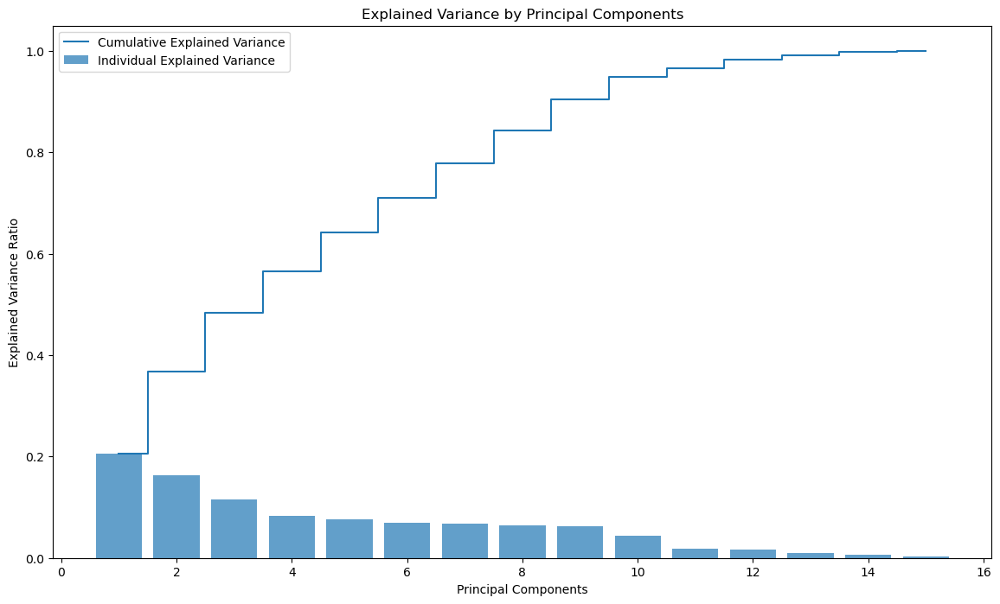

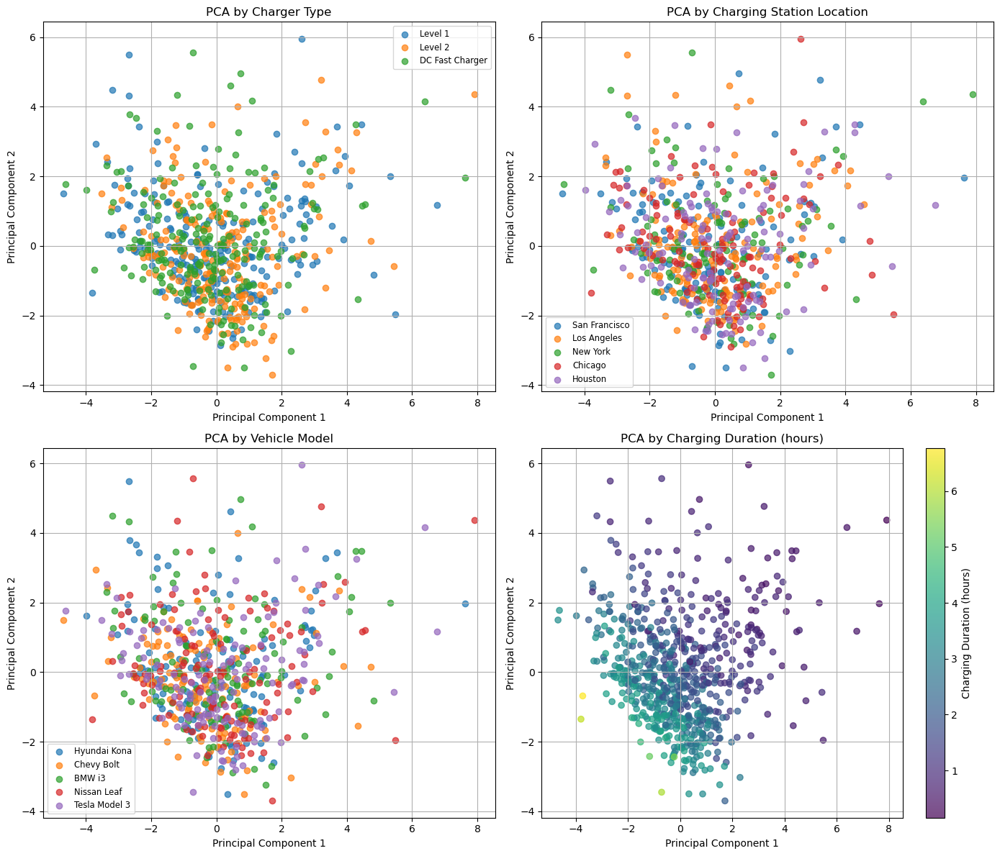

In [60]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import pandas as pd



# Selección de columnas numéricas relevantes
numerical_data = data_cleaned.select_dtypes(include=['float64', 'int64'])

# Manejo de NaN: eliminar filas con valores NaN
numerical_data = numerical_data.dropna()

# Estandarización de los datos
scaler = StandardScaler()
standardized_data = scaler.fit_transform(numerical_data)

# Chequea si hay NaN después de la estandarización
print(np.isnan(standardized_data).any())

print((numerical_data.std() == 0).any())


# Aplicar PCA
pca = PCA()
pca.fit(standardized_data)

# Varianza explicada
explained_variance_ratio = pca.explained_variance_ratio_
cumulative_variance_ratio = pca.explained_variance_ratio_.cumsum()

# Gráfico de varianza explicada
plt.figure(figsize=(14, 8))
plt.bar(range(1, len(explained_variance_ratio) + 1), explained_variance_ratio, alpha=0.7, align='center',
        label='Individual Explained Variance')
plt.step(range(1, len(cumulative_variance_ratio) + 1), cumulative_variance_ratio, where='mid',
         label='Cumulative Explained Variance')
plt.xlabel('Principal Components')
plt.ylabel('Explained Variance Ratio')
plt.legend(loc='best')
plt.title('Explained Variance by Principal Components')
plt.show()

# # Proyección de los datos en las dos primeras componentes principales
pca_2d = PCA(n_components=2)

# Continuamos desde donde se hizo la estandarización y PCA
pca_2d_result = pca_2d.fit_transform(standardized_data)
pca_df = pd.DataFrame(data=pca_2d_result, columns=['PC1', 'PC2'])

# Añadimos las columnas de categorización al DataFrame PCA
categorical_columns_data = data_cleaned.loc[numerical_data.index]

pca_df['Charger Type'] = categorical_columns_data['Charger Type'].values
pca_df['Charging Station Location'] = categorical_columns_data['Charging Station Location'].values
pca_df['Vehicle Model'] = categorical_columns_data['Vehicle Model'].values
pca_df['Charging Duration (hours)'] = categorical_columns_data['Charging Duration (hours)'].values

# Creación de subplots 2x2
fig, axes = plt.subplots(2, 2, figsize=(14, 12))

# Lista de variables categóricas y continua para cada subplot
categorical_columns = ['Charger Type', 'Charging Station Location', 'Vehicle Model']
titles = ['Charger Type', 'Charging Station Location', 'Vehicle Model', 'Charging Duration (hours)']

# Gráficos de dispersión para variables categóricas
for ax, column, title in zip(axes.flatten()[:3], categorical_columns, titles[:3]):
    for category in pca_df[column].unique():
        subset = pca_df[pca_df[column] == category]
        ax.scatter(subset['PC1'], subset['PC2'], label=category, alpha=0.7)
    ax.set_title(f'PCA by {title}')
    ax.set_xlabel('Principal Component 1')
    ax.set_ylabel('Principal Component 2')
    ax.legend(loc='best', fontsize='small')
    ax.grid(True)

# Gráfico de dispersión para la variable continua
ax = axes.flatten()[3]
sc = ax.scatter(pca_df['PC1'], pca_df['PC2'], c=pca_df['Charging Duration (hours)'], cmap='viridis', alpha=0.7)
ax.set_title('PCA by Charging Duration (hours)')
ax.set_xlabel('Principal Component 1')
ax.set_ylabel('Principal Component 2')
ax.grid(True)
cbar = plt.colorbar(sc, ax=ax)
cbar.set_label('Charging Duration (hours)')

plt.tight_layout()
plt.show()




## Linear Regression

In [61]:
from sklearn.linear_model import LinearRegression
import pandas as pd

# Seleccionar las variables independientes y la dependiente
X = data_cleaned.drop(columns=["Charging Duration (hours)", "Vehicle Model", "Charging Station Location", "Charger Type", "Charger Efficiency", "Charge Rate (%/h)", "Charging Efficiency (kWh/h)"])
# Las 3 últimas no se pueden usar porque se han calculado dichas columnas con Charging Duration.
y = data_cleaned["Charging Duration (hours)"]

# Ajustar el modelo
model = LinearRegression()
model.fit(X, y)

# Obtener la importancia de las características
feature_importance = pd.DataFrame({
    'Feature': X.columns,
    'Importance': model.coef_
}).sort_values(by="Importance", key=abs, ascending=False)

print(feature_importance)


                             Feature  Importance
8                   Distance per kWh   -0.016526
6                Vehicle Age (years)    0.010517
5                   Temperature (°C)   -0.005331
7                Energy per Charge %   -0.004703
2                 Charging Rate (kW)   -0.003155
3                Charging Cost (USD)    0.002857
0             Battery Capacity (kWh)   -0.002639
4                Distance Driven(km)    0.001927
9                Total Charge Gained    0.001452
1              Energy Consumed (kWh)   -0.001183
10  Temperature Adjusted Consumption   -0.000309


In [62]:
from sklearn.linear_model import Lasso

# Ajustar el modelo Lasso
lasso = Lasso(alpha=0.01)  # Ajustar alpha según sea necesario
lasso.fit(X, y)

# Importancia de las características
feature_importance_lasso = pd.DataFrame({
    'Feature': X.columns,
    'Importance': lasso.coef_
}).sort_values(by="Importance", key=abs, ascending=False)

print(feature_importance_lasso)


                             Feature  Importance
8                   Distance per kWh   -0.015849
6                Vehicle Age (years)    0.008660
5                   Temperature (°C)   -0.005004
7                Energy per Charge %   -0.004602
2                 Charging Rate (kW)   -0.003115
3                Charging Cost (USD)    0.002760
0             Battery Capacity (kWh)   -0.002604
4                Distance Driven(km)    0.001904
9                Total Charge Gained    0.001442
1              Energy Consumed (kWh)   -0.001234
10  Temperature Adjusted Consumption   -0.000195


In [63]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

# Suponiendo que 'X' es la variable más representativa
X = data_cleaned.drop(columns=["Charging Duration (hours)", "Vehicle Model", "Charging Station Location", "Charger Type", "Charger Efficiency", "Charge Rate (%/h)", "Charging Efficiency (kWh/h)"])

#X = data_cleaned[["Distance per kWh"]]  # Reemplaza con el nombre de la variable seleccionada
y = data_cleaned["Charging Duration (hours)"]

# Dividir en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.15, random_state=42)

# Entrenar el modelo de regresión lineal
model = LinearRegression()
model.fit(X_train, y_train)

# Predecir en el conjunto de prueba
y_pred = model.predict(X_test)

# Evaluar el modelo
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f"MAE: {mae:.2f} horas")
print(f"MSE: {mse:.2f}")
print(f"R²: {r2:.2f}")



MAE: 0.87 horas
MSE: 1.07
R²: -0.00


MAE: 0.88 horas
MSE: 1.07
R²: -0.00


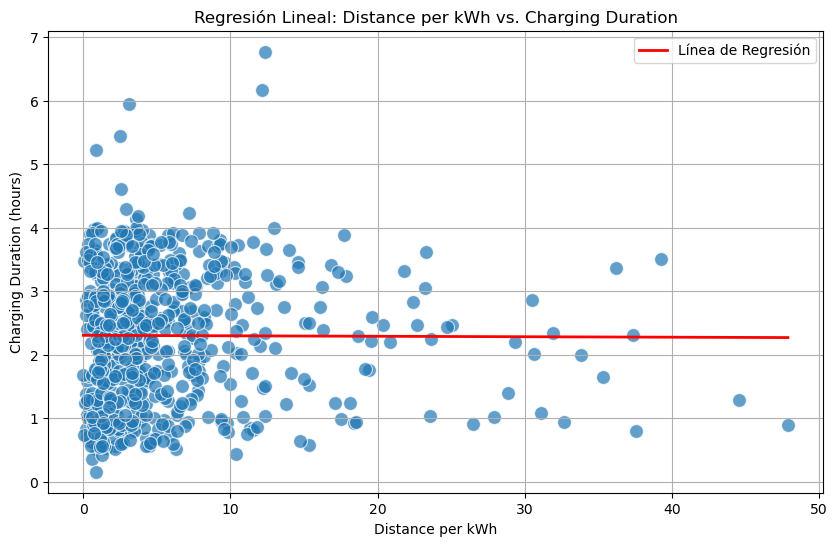

In [64]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

# Suponiendo que 'X' es la variable más representativa

X = data_cleaned[["Distance per kWh"]]  # Reemplaza con el nombre de la variable seleccionada
y = data_cleaned["Charging Duration (hours)"]

# Dividir en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.15, random_state=42)

# Entrenar el modelo de regresión lineal
model = LinearRegression()
model.fit(X_train, y_train)

# Predecir en el conjunto de prueba
y_pred = model.predict(X_test)

# Evaluar el modelo
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f"MAE: {mae:.2f} horas")
print(f"MSE: {mse:.2f}")
print(f"R²: {r2:.2f}")

# Predecir la línea de regresión
x_range = np.linspace(X.min(), X.max(), 100).reshape(-1, 1)
y_pred = model.predict(x_range)

# Gráfico de dispersión con línea de regresión
plt.figure(figsize=(10, 6))
sns.scatterplot(x=X.squeeze(), y=y, alpha=0.7, s=100)

# Añadir la línea de regresión
plt.plot(x_range, y_pred, color="red", linewidth=2, label="Línea de Regresión")

# Configurar etiquetas y título
plt.title("Regresión Lineal: Distance per kWh vs. Charging Duration")
plt.xlabel("Distance per kWh")
plt.ylabel("Charging Duration (hours)")
plt.legend()
plt.grid(True)

# Mostrar gráfico
plt.show()


In [65]:
from sklearn.linear_model import Lasso, Ridge, ElasticNet
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

# Supongamos que 'Selected Feature' es la variable más representativa
X = data_cleaned.drop(columns=["Charging Duration (hours)", "Vehicle Model", "Charging Station Location", "Charger Type", "Charger Efficiency", "Charge Rate (%/h)", "Charging Efficiency (kWh/h)"])

#X = data_cleaned[["Distance per kWh"]]  # Reemplaza con tu variable
y = data_cleaned["Charging Duration (hours)"]

# Dividir en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Inicializar modelos con hiperparámetros básicos
lasso = Lasso(alpha=0.001)
ridge = Ridge(alpha=1.0)
elasticnet = ElasticNet(alpha=0.1, l1_ratio=0.5)

# Ajustar los modelos
lasso.fit(X_train, y_train)
ridge.fit(X_train, y_train)
elasticnet.fit(X_train, y_train)

# Predecir en el conjunto de prueba
y_pred_lasso = lasso.predict(X_test)
y_pred_ridge = ridge.predict(X_test)
y_pred_elasticnet = elasticnet.predict(X_test)

# Evaluar los modelos
results = {
    'Model': ['Lasso', 'Ridge', 'ElasticNet'],
    'MAE': [
        mean_absolute_error(y_test, y_pred_lasso),
        mean_absolute_error(y_test, y_pred_ridge),
        mean_absolute_error(y_test, y_pred_elasticnet)
    ],
    'MSE': [
        mean_squared_error(y_test, y_pred_lasso),
        mean_squared_error(y_test, y_pred_ridge),
        mean_squared_error(y_test, y_pred_elasticnet)
    ],
    'R²': [
        r2_score(y_test, y_pred_lasso),
        r2_score(y_test, y_pred_ridge),
        r2_score(y_test, y_pred_elasticnet)
    ]
}

# Mostrar los resultados
import pandas as pd
results_df = pd.DataFrame(results)
print(results_df)




        Model       MAE       MSE        R²
0       Lasso  0.872681  1.076262 -0.024464
1       Ridge  0.872668  1.076193 -0.024399
2  ElasticNet  0.874457  1.080053 -0.028073


        Model       MAE       MSE        R²
0       Lasso  0.868697  1.050865 -0.000290
1       Ridge  0.869857  1.054046 -0.003318
2  ElasticNet  0.869017  1.052355 -0.001708


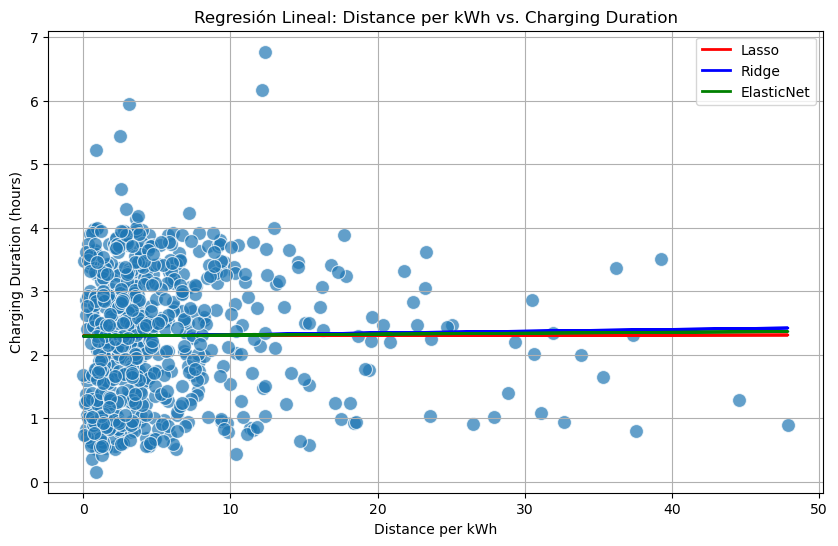

In [66]:
from sklearn.linear_model import Lasso, Ridge, ElasticNet
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

# Supongamos que 'Selected Feature' es la variable más representativa

X = data_cleaned[["Distance per kWh"]]  # Reemplaza con tu variable
y = data_cleaned["Charging Duration (hours)"]

# Dividir en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Inicializar modelos con hiperparámetros básicos
lasso = Lasso(alpha=0.1)
ridge = Ridge(alpha=1.0)
elasticnet = ElasticNet(alpha=0.1, l1_ratio=0.5)

# Ajustar los modelos
lasso.fit(X_train, y_train)
ridge.fit(X_train, y_train)
elasticnet.fit(X_train, y_train)

# Predecir en el conjunto de prueba
y_pred_lasso = lasso.predict(X_test)
y_pred_ridge = ridge.predict(X_test)
y_pred_elasticnet = elasticnet.predict(X_test)

# Evaluar los modelos
results = {
    'Model': ['Lasso', 'Ridge', 'ElasticNet'],
    'MAE': [
        mean_absolute_error(y_test, y_pred_lasso),
        mean_absolute_error(y_test, y_pred_ridge),
        mean_absolute_error(y_test, y_pred_elasticnet)
    ],
    'MSE': [
        mean_squared_error(y_test, y_pred_lasso),
        mean_squared_error(y_test, y_pred_ridge),
        mean_squared_error(y_test, y_pred_elasticnet)
    ],
    'R²': [
        r2_score(y_test, y_pred_lasso),
        r2_score(y_test, y_pred_ridge),
        r2_score(y_test, y_pred_elasticnet)
    ]
}

# Mostrar los resultados
import pandas as pd
results_df = pd.DataFrame(results)
print(results_df)

#x_range = np.linspace(X.min(), X.max(), 100).reshape(-1, 1)

# Gráfico de dispersión con línea de regresión
plt.figure(figsize=(10, 6))
sns.scatterplot(x=X.squeeze(), y=y, alpha=0.7, s=100)

# Añadir la línea de regresión
plt.plot(X_test, y_pred_lasso, color="red", linewidth=2, label="Lasso")
plt.plot(X_test, y_pred_ridge, color="blue", linewidth=2, label="Ridge")
plt.plot(X_test, y_pred_elasticnet, color="green", linewidth=2, label="ElasticNet")

# Configurar etiquetas y título
plt.title("Regresión Lineal: Distance per kWh vs. Charging Duration")
plt.xlabel("Distance per kWh")
plt.ylabel("Charging Duration (hours)")
plt.legend()
plt.grid(True)

# Mostrar gráfico
plt.show()



        Model       MAE       MSE        R²
0       Lasso  0.866738  1.047992  0.002445
1       Ridge  0.866452  1.047822  0.002607
2  ElasticNet  0.866595  1.047899  0.002534


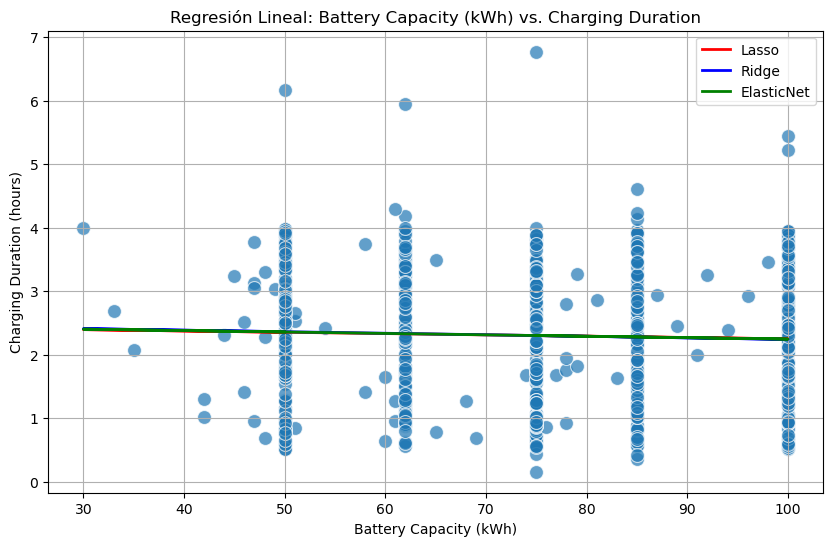

In [67]:
from sklearn.linear_model import Lasso, Ridge, ElasticNet
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

# Supongamos que 'Selected Feature' es la variable más representativa
X = data_cleaned[["Battery Capacity (kWh)"]]  # Reemplaza con tu variable
y = data_cleaned["Charging Duration (hours)"]

# Dividir en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Inicializar modelos con hiperparámetros básicos
lasso = Lasso(alpha=0.1)
ridge = Ridge(alpha=1.0)
elasticnet = ElasticNet(alpha=0.1, l1_ratio=0.5)

# Ajustar los modelos
lasso.fit(X_train, y_train)
ridge.fit(X_train, y_train)
elasticnet.fit(X_train, y_train)

# Predecir en el conjunto de prueba
y_pred_lasso = lasso.predict(X_test)
y_pred_ridge = ridge.predict(X_test)
y_pred_elasticnet = elasticnet.predict(X_test)

# Evaluar los modelos
results = {
    'Model': ['Lasso', 'Ridge', 'ElasticNet'],
    'MAE': [
        mean_absolute_error(y_test, y_pred_lasso),
        mean_absolute_error(y_test, y_pred_ridge),
        mean_absolute_error(y_test, y_pred_elasticnet)
    ],
    'MSE': [
        mean_squared_error(y_test, y_pred_lasso),
        mean_squared_error(y_test, y_pred_ridge),
        mean_squared_error(y_test, y_pred_elasticnet)
    ],
    'R²': [
        r2_score(y_test, y_pred_lasso),
        r2_score(y_test, y_pred_ridge),
        r2_score(y_test, y_pred_elasticnet)
    ]
}

# Mostrar los resultados
import pandas as pd
results_df = pd.DataFrame(results)
print(results_df)

#x_range = np.linspace(X.min(), X.max(), 100).reshape(-1, 1)

# Gráfico de dispersión con línea de regresión
plt.figure(figsize=(10, 6))
sns.scatterplot(x=X.squeeze(), y=y, alpha=0.7, s=100)

# Añadir la línea de regresión
plt.plot(X_test, y_pred_lasso, color="red", linewidth=2, label="Lasso")
plt.plot(X_test, y_pred_ridge, color="blue", linewidth=2, label="Ridge")
plt.plot(X_test, y_pred_elasticnet, color="green", linewidth=2, label="ElasticNet")

# Configurar etiquetas y título
plt.title("Regresión Lineal: Battery Capacity (kWh) vs. Charging Duration")
plt.xlabel("Battery Capacity (kWh)")
plt.ylabel("Charging Duration (hours)")
plt.legend()
plt.grid(True)

# Mostrar gráfico
plt.show()



## Regresión Logística

### Descripción del Modelo de Predicción

El modelo de **Regresión Logística** intenta predecir si un usuario pertenece a una categoría específica de uso de la estación de carga, representada por `User Type = 1`, o no (`User Type = 0`). Dado el criterio `Charging Duration (hours) > 2` y `Energy Consumed (kWh) > 20`, el modelo está clasificando a los usuarios de la siguiente manera:

- **User Type = 1**: Usuarios que suelen realizar **sesiones de carga más largas** (más de 2 horas) y **consumen más energía** (más de 20 kWh) por sesión. Estos usuarios pueden necesitar una carga profunda, posiblemente debido a baterías de alta capacidad o un mayor uso que requiere cargas completas.

- **User Type = 0**: Usuarios con **sesiones de carga más cortas** (de 2 horas o menos) o **consumos menores** (20 kWh o menos). Esto podría indicar un patrón de carga frecuente pero de menor duración, o cargas de "mantenimiento" sin agotar completamente la batería.


In [68]:
import numpy as np
import pandas as pd

# Definir rangos de umbrales para la duración de carga y la energía consumida
charging_duration_thresholds = np.arange(1, 5, 1)  # por ejemplo, de 1 a 5 horas
energy_consumed_thresholds = np.arange(20, 50, 10)  # por ejemplo, de 20 a 50 kWh

# Almacenar resultados de balance para cada combinación
balance_results = []
data_with_user_type = data_cleaned.copy()

# Iterar sobre todas las combinaciones de umbrales
for duration_thresh in charging_duration_thresholds:
    for energy_thresh in energy_consumed_thresholds:
        # Definir User Type dinámicamente en función de los umbrales actuales
        data_with_user_type['User Type'] = data_with_user_type.apply(
            lambda x: 1 if x['Charging Duration (hours)'] > duration_thresh and x['Energy Consumed (kWh)'] > energy_thresh else 0,
            axis=1
        )
        
        # Calcular la distribución de 1s y 0s
        value_counts = data_with_user_type['User Type'].value_counts()
        
        # Obtener la cantidad de 1s y 0s
        count_0 = value_counts.get(0, 0)
        count_1 = value_counts.get(1, 0)
        
        # Calcular el balance (diferencia relativa entre 1s y 0s)
        total = count_0 + count_1
        balance_ratio = abs(count_1 - count_0) / total if total > 0 else 1  # Ratio de balance (0 = perfecto, 1 = desequilibrado)
        
        # Almacenar los resultados de esta combinación
        balance_results.append({
            'Charging Duration Threshold': duration_thresh,
            'Energy Consumed Threshold': energy_thresh,
            'Count 0': count_0,
            'Count 1': count_1,
            'Total': total,
            'Balance Ratio': balance_ratio
        })

# Convertir los resultados a un dataframe para ordenar
balance_df = pd.DataFrame(balance_results)

# Ordenar por Balance Ratio de menor a mayor (de más balanceado a menos balanceado)
balance_df = balance_df.sort_values(by='Balance Ratio', ascending=True).reset_index(drop=True)

# Mostrar los resultados ordenados
print("Combinaciones de umbrales de más balanceada a menos balanceada:")
print(balance_df)


Combinaciones de umbrales de más balanceada a menos balanceada:
    Charging Duration Threshold  Energy Consumed Threshold  Count 0  Count 1  \
0                             2                         20      338      337   
1                             1                         40      343      332   
2                             2                         30      393      282   
3                             1                         30      269      406   
4                             2                         40      442      233   
5                             1                         20      192      483   
6                             3                         20      516      159   
7                             3                         30      544      131   
8                             3                         40      563      112   
9                             4                         20      667        8   
10                            4                         


Resultados para Ridge:
Precisión promedio: 0.8311111111111111
Matriz de Confusión:
 [[275  63]
 [ 51 286]]
AUC: 0.8943251452952435

Reporte de Clasificación:
              precision    recall  f1-score   support

           0       0.84      0.81      0.83       338
           1       0.82      0.85      0.83       337

    accuracy                           0.83       675
   macro avg       0.83      0.83      0.83       675
weighted avg       0.83      0.83      0.83       675



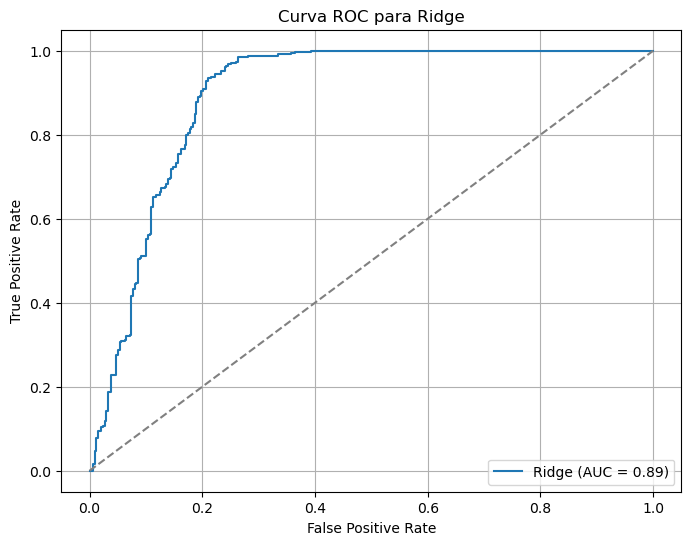


Resultados para Lasso:
Precisión promedio: 0.8444444444444444
Matriz de Confusión:
 [[278  60]
 [ 45 292]]
AUC: 0.9050006145418152

Reporte de Clasificación:
              precision    recall  f1-score   support

           0       0.86      0.82      0.84       338
           1       0.83      0.87      0.85       337

    accuracy                           0.84       675
   macro avg       0.85      0.84      0.84       675
weighted avg       0.85      0.84      0.84       675



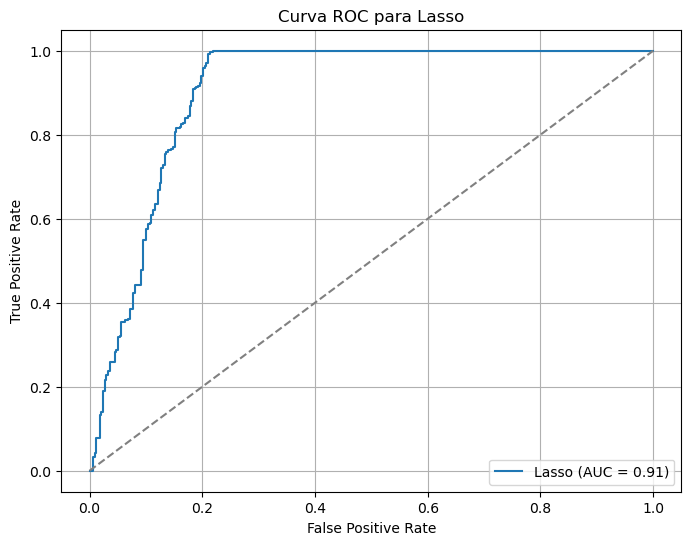


Resultados para Elastic Net:
Precisión promedio: 0.8296296296296296
Matriz de Confusión:
 [[274  64]
 [ 51 286]]
AUC: 0.8953786455498394

Reporte de Clasificación:
              precision    recall  f1-score   support

           0       0.84      0.81      0.83       338
           1       0.82      0.85      0.83       337

    accuracy                           0.83       675
   macro avg       0.83      0.83      0.83       675
weighted avg       0.83      0.83      0.83       675



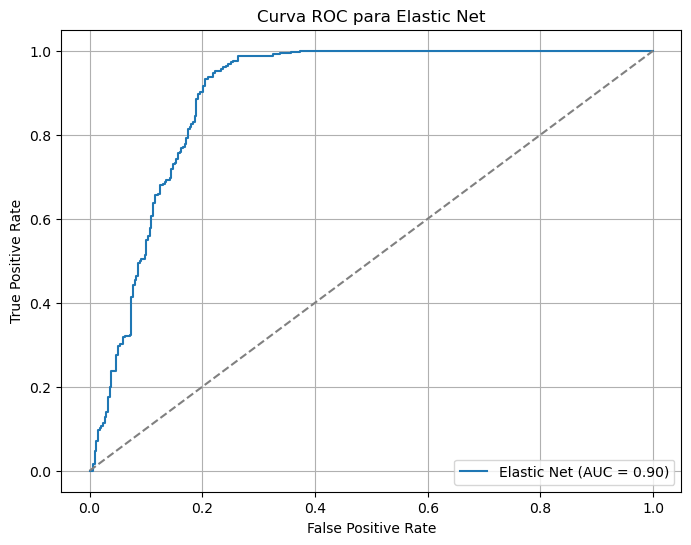

In [86]:
import pandas as pd
from sklearn.linear_model import LogisticRegressionCV
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report, roc_auc_score, roc_curve
import matplotlib.pyplot as plt

# Crear una copia del dataframe y definir el tipo de usuario en el nuevo dataframe
data_with_user_type = data_cleaned.copy()
data_with_user_type['User Type'] = data_with_user_type.apply(
    lambda x: 1 if x['Charging Duration (hours)'] > 2 and x['Energy Consumed (kWh)'] > 20 else 0,
    axis=1
)

# Definir las variables predictoras y la nueva variable objetivo
X = data_with_user_type[['Battery Capacity (kWh)', 'Charging Duration (hours)', 'Charging Rate (kW)', 'Temperature (°C)']]
y = data_with_user_type['User Type']

# Inicializar diccionarios para almacenar resultados
results = {}

# Definir los modelos con diferentes tipos de penalización
penalties = {'Ridge': 'l2', 'Lasso': 'l1', 'Elastic Net': 'elasticnet'}

for name, penalty in penalties.items():
    print(f"\nResultados para {name}:")

    # Configurar el modelo de LogisticRegressionCV
    model = LogisticRegressionCV(
        cv=5,
        penalty=penalty,
        solver='saga',  # 'saga' es el único solver que soporta L1, L2 y elasticnet en LogisticRegressionCV
        scoring='accuracy',
        max_iter=1000,
        random_state=42,
        l1_ratios=[0.5] if penalty == 'elasticnet' else None  # Usar 0.5 para Elastic Net
    )
    
    # Entrenar el modelo
    model.fit(X, y)
    
    # Obtener predicciones y probabilidades
    y_pred = model.predict(X)
    y_prob = model.predict_proba(X)[:, 1]
    
    # Calcular y almacenar métricas de rendimiento
    results[name] = {
        'accuracy': accuracy_score(y, y_pred),
        'confusion_matrix': confusion_matrix(y, y_pred),
        'classification_report': classification_report(y, y_pred, output_dict=True),
        'auc': roc_auc_score(y, y_prob)
    }

    # Mostrar los resultados de cada modelo
    print("Precisión promedio:", results[name]['accuracy'])
    print("Matriz de Confusión:\n", results[name]['confusion_matrix'])
    print("AUC:", results[name]['auc'])
    print("\nReporte de Clasificación:")
    print(classification_report(y, y_pred))
    
    # Curva ROC
    fpr, tpr, _ = roc_curve(y, y_prob)
    plt.figure(figsize=(8, 6))
    plt.plot(fpr, tpr, label=f'{name} (AUC = {results[name]["auc"]:.2f})')
    plt.plot([0, 1], [0, 1], color='gray', linestyle='--')
    plt.xlabel("False Positive Rate")
    plt.ylabel("True Positive Rate")
    plt.title(f"Curva ROC para {name}")
    plt.legend(loc="lower right")
    plt.grid(True)
    plt.show()


### Resumen de Resultados del Modelo con Regularización Lasso

El modelo de **regresión logística con Lasso (L1)** alcanzó un buen desempeño en la clasificación:

- **Precisión promedio**: 84.4%
- **AUC**: 0.905, indicando una excelente capacidad para distinguir entre clases.

#### Matriz de Confusión

|                 | Predicción Negativa | Predicción Positiva |
|-----------------|---------------------|---------------------|
| **Real Negativo** | 278                 | 60                  |
| **Real Positivo** | 45                  | 292                |

Este modelo presenta un buen equilibrio entre clases y destaca por su alta discriminación entre clases, simplificando la selección de variables relevantes con Lasso.


## Clusterización:



### Hierarchical Clustering:

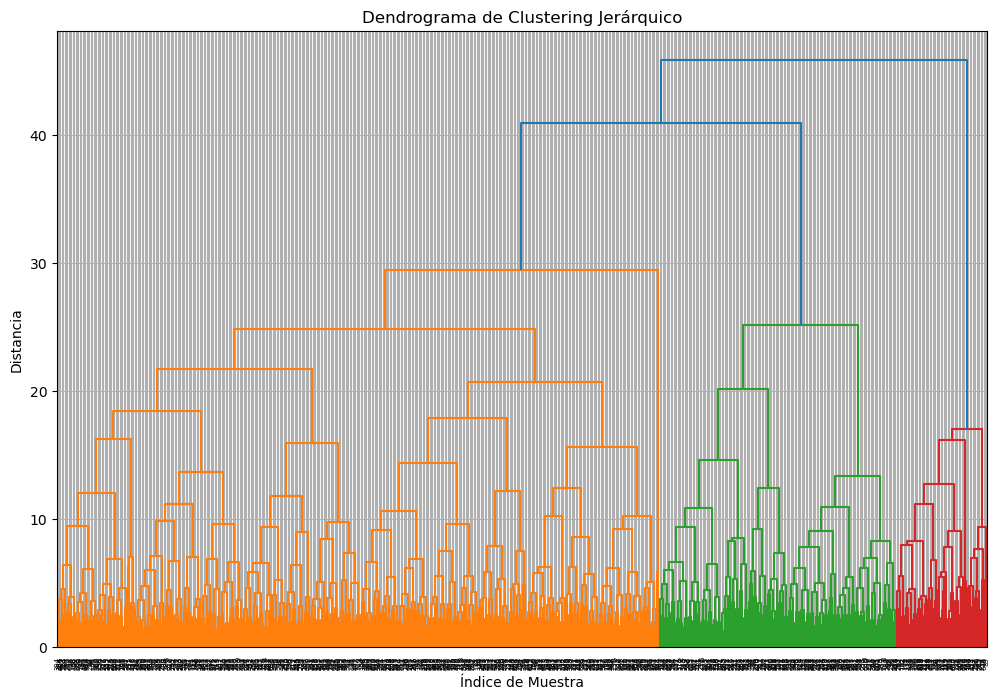

In [70]:
import pandas as pd
from sklearn.preprocessing import StandardScaler
from scipy.cluster.hierarchy import dendrogram, linkage
import matplotlib.pyplot as plt
import seaborn as sns

# Seleccionar solo las columnas numéricas
numeric_columns = data_cleaned.select_dtypes(include=[float, int])
X = numeric_columns

# Estandarizar los datos
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Aplicar clustering jerárquico
linked = linkage(X_scaled, method='ward')

# Crear dendrograma
plt.figure(figsize=(12, 8))
dendrogram(linked,
           orientation='top',
           distance_sort='descending',
           show_leaf_counts=True)
plt.title('Dendrograma de Clustering Jerárquico')
plt.xlabel('Índice de Muestra')
plt.xticks(rotation=90)
plt.ylabel('Distancia')
plt.grid(True)
plt.show()


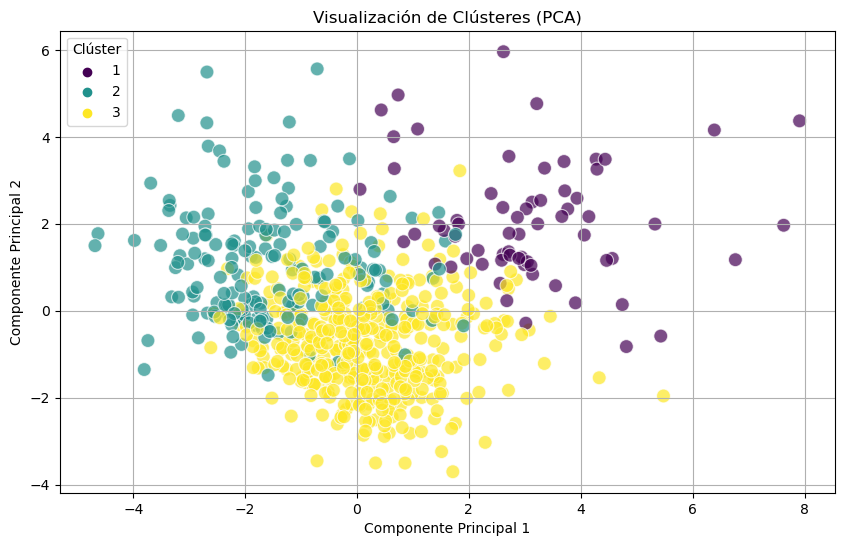

In [71]:
from scipy.cluster.hierarchy import fcluster

# Decidir el número de clústeres basado en una distancia o número deseado
num_clusters = 3  # Cambia esto según tus necesidades
cluster_labels = fcluster(linked, num_clusters, criterion='maxclust')

# Añadir etiquetas de clúster al DataFrame original
data_cleaned['Cluster_Hier'] = cluster_labels

from sklearn.decomposition import PCA

# Reducir dimensiones a 2 para visualización
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_scaled)

# Scatter plot con los clústeres
plt.figure(figsize=(10, 6))
sns.scatterplot(x=X_pca[:, 0], y=X_pca[:, 1], hue=cluster_labels, palette='viridis', s=100, alpha=0.7)
plt.title('Visualización de Clústeres (PCA)')
plt.xlabel('Componente Principal 1')
plt.ylabel('Componente Principal 2')
plt.legend(title='Clúster')
plt.grid(True)
plt.show()

### K-Means:

Exception in thread Thread-7 (_readerthread):
Traceback (most recent call last):
  File "c:\Users\luis_\anaconda3\Lib\threading.py", line 1038, in _bootstrap_inner
    self.run()
  File "c:\Users\luis_\anaconda3\Lib\threading.py", line 975, in run
    self._target(*self._args, **self._kwargs)
  File "c:\Users\luis_\anaconda3\Lib\subprocess.py", line 1597, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xa0 in position 16: invalid start byte
  File "c:\Users\luis_\anaconda3\Lib\site-packages\joblib\externals\loky\backend\context.py", line 217, in _count_physical_cores
    raise ValueError(


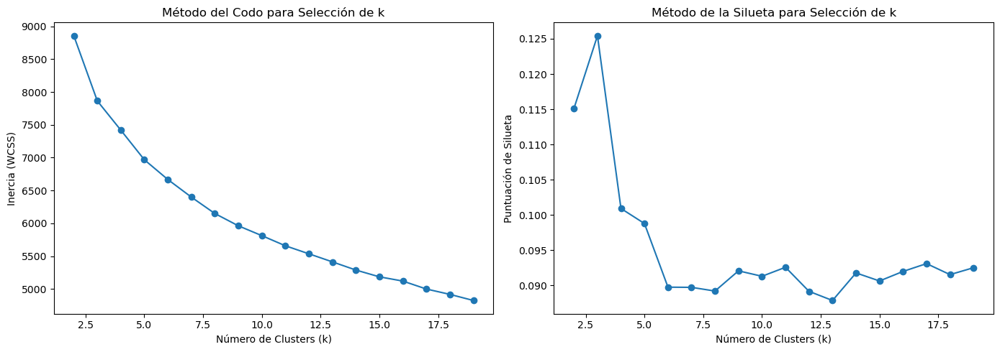

Best number of clusters with silhouette: 3
Best number of clusters with elbow method: 2


In [72]:
import pandas as pd
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt

# Seleccionar variables numéricas para clustering
data_for_clustering = data_cleaned.select_dtypes(include=[float, int])

# Normalizar los datos
scaler = StandardScaler()
data_scaled = scaler.fit_transform(data_for_clustering)

# Inicializar listas para almacenar los resultados
wcss = []  # Inercia dentro de los clusters para el método del codo
silhouette_scores = []  # Puntuación de silueta para cada k

# Probar diferentes valores de k (número de clusters)
for k in range(2, 20):
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(data_scaled)
    wcss.append(kmeans.inertia_)
    
    # Calcular el coeficiente de silueta para el número de clusters actual
    score = silhouette_score(data_scaled, kmeans.labels_)
    silhouette_scores.append(score)

# Graficar el método del codo
plt.figure(figsize=(14, 5))

plt.subplot(1, 2, 1)
plt.plot(range(2, 20), wcss, marker='o', linestyle='-')
plt.xlabel("Número de Clusters (k)")
plt.ylabel("Inercia (WCSS)")
plt.title("Método del Codo para Selección de k")

# Graficar el método de la silueta
plt.subplot(1, 2, 2)
plt.plot(range(2, 20), silhouette_scores, marker='o', linestyle='-')
plt.xlabel("Número de Clusters (k)")
plt.ylabel("Puntuación de Silueta")
plt.title("Método de la Silueta para Selección de k")

plt.tight_layout()
plt.show()

# Seleccionar el mejor K basado en el índice de Silhouette
best_k_sil = np.argmax(silhouette_scores) + 2  # +2 porque empezamos en K=2
print(f'Best number of clusters with silhouette: {best_k_sil}')

# Método del codo: calcular la mayor pendiente (inflexión)
def optimal_number_of_clusters(wcss):
    slopes = np.diff(wcss)  # Diferencias entre valores consecutivos
    slope_changes = np.diff(slopes)  # Cambios en la pendiente entre puntos consecutivos
    # Encontrar el índice del mayor cambio absoluto en la pendiente
    return np.argmax(slope_changes) + 2  # +2 porque np.diff reduce en 2 y k empieza en 2

# Método del codo (calculando la mayor pendiente)
best_k_cod = optimal_number_of_clusters(wcss)
print(f'Best number of clusters with elbow method: {best_k_cod}')



In [73]:
# Entrenar modelos KMeans con el mejor K encontrado
kmeans_sil = KMeans(n_clusters=best_k_sil, random_state=42)
kmeans_sil.fit(data_scaled)

kmeans_cod = KMeans(n_clusters=best_k_cod, random_state=42)
kmeans_cod.fit(data_scaled)

# Añadir las etiquetas de cluster al DataFrame original
data_cleaned['Cluster_Sil'] = kmeans_sil.labels_
data_cleaned['Cluster_Elbow'] = kmeans_cod.labels_



In [74]:
# Reemplazar los números por etiquetas de texto
data_cleaned['Cluster_Sil'] = data_cleaned['Cluster_Sil'].replace({0: 2, 2: 0})

data_cleaned['Cluster_Hier'] = data_cleaned['Cluster_Hier'].apply(lambda x: f'Group {x}')
data_cleaned['Cluster_Sil'] = data_cleaned['Cluster_Sil'].apply(lambda x: f'Group {str(x+1)}')
data_cleaned['Cluster_Elbow'] = data_cleaned['Cluster_Elbow'].apply(lambda x: f'Group {str(x+1)}')





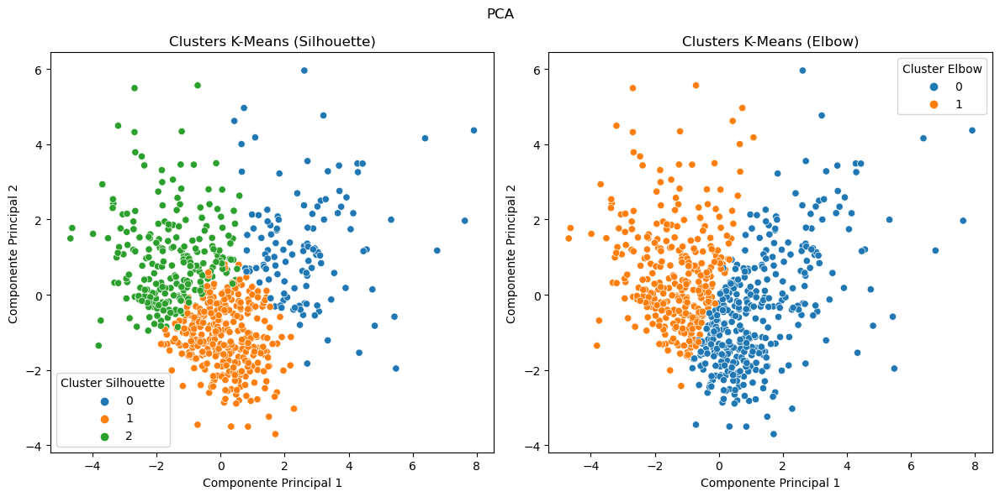

In [75]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans


# Aplicar PCA para reducir a 2 dimensiones
pca = PCA(n_components=2)
data_pca = pca.fit_transform(data_scaled)

# Crear un modelo K-Means con el número de clusters óptimo (ajusta k según el análisis anterior)
#k = 3  # Ajusta este valor según el método del codo o la silueta
#kmeans = KMeans(n_clusters=k, random_state=42)
#data_cleaned['Cluster_Sil'] = kmeans.fit_predict(data_scaled)

# Crear un DataFrame con los resultados PCA y los clusters
data_pca_df = pd.DataFrame(data_pca, columns=['PCA1', 'PCA2'])
data_pca_df['Cluster_Sil'] = kmeans_sil.labels_
data_pca_df['Cluster_Elbow'] = kmeans_cod.labels_

# Graficar los resultados para los clusters de silueta
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
sns.scatterplot(data=data_pca_df, x='PCA1', y='PCA2', hue='Cluster_Sil', palette=sns.color_palette("tab10", best_k_sil), legend='full')
plt.title('Clusters K-Means (Silhouette)')
plt.xlabel('Componente Principal 1')
plt.ylabel('Componente Principal 2')
plt.legend(title='Cluster Silhouette')

# Graficar los resultados para los clusters del codo

plt.subplot(1, 2, 2)
sns.scatterplot(data=data_pca_df, x='PCA1', y='PCA2', hue='Cluster_Elbow', palette=sns.color_palette("tab10", best_k_cod), legend='full')
plt.title('Clusters K-Means (Elbow)')
plt.xlabel('Componente Principal 1')
plt.ylabel('Componente Principal 2')
plt.legend(title='Cluster Elbow')

plt.suptitle('PCA')
plt.tight_layout()
plt.show()



- Se ha optado por un K=3 debido a que hay un mayor balance en términos de compactabilidad y separación entre clusters. Los clusters podrían estar reflejando diferencias en características clave, como tasas de consumo de energía, eficiencia de carga, o comportamiento de uso, según los atributos que caracterizan cada grupo.

- Hay cierta superposición entre el Cluster 1 y el Cluster 2, lo que podría sugerir que estos dos clusters comparten algunas similitudes o que hay algunos puntos en la frontera que podrían pertenecer a ambos clusters.

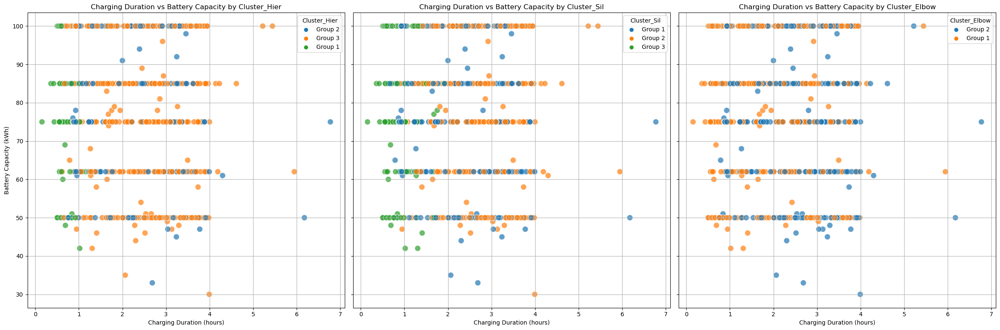

In [76]:
import seaborn as sns
import matplotlib.pyplot as plt

# Configuración de la figura con 3 subplots
fig, axes = plt.subplots(1, 3, figsize=(24, 8), sharex=True, sharey=True)

# Listas de clústeres y títulos
clusters = ['Cluster_Hier', 'Cluster_Sil', 'Cluster_Elbow']
titles = ['Cluster_Hier', 'Cluster_Sil', 'Cluster_Elbow']

# Iterar sobre los subplots y los clústeres
for ax, cluster, title in zip(axes, clusters, titles):
    sns.scatterplot(
        data=data_cleaned,
        x='Charging Duration (hours)', 
        y='Battery Capacity (kWh)', 
        hue=cluster,  # Cambiar el clúster
        palette='tab10',  # Paleta de colores discretos
        s=100,  # Tamaño de los puntos
        alpha=0.7,  # Transparencia
        ax=ax  # Asignar subplot
    )
    ax.set_title(f'Charging Duration vs Battery Capacity by {title}')
    ax.set_xlabel('Charging Duration (hours)')
    ax.set_ylabel('Battery Capacity (kWh)')
    ax.grid(True)
    ax.legend(title=title)

plt.tight_layout()
plt.show()


<Figure size 1200x1200 with 0 Axes>

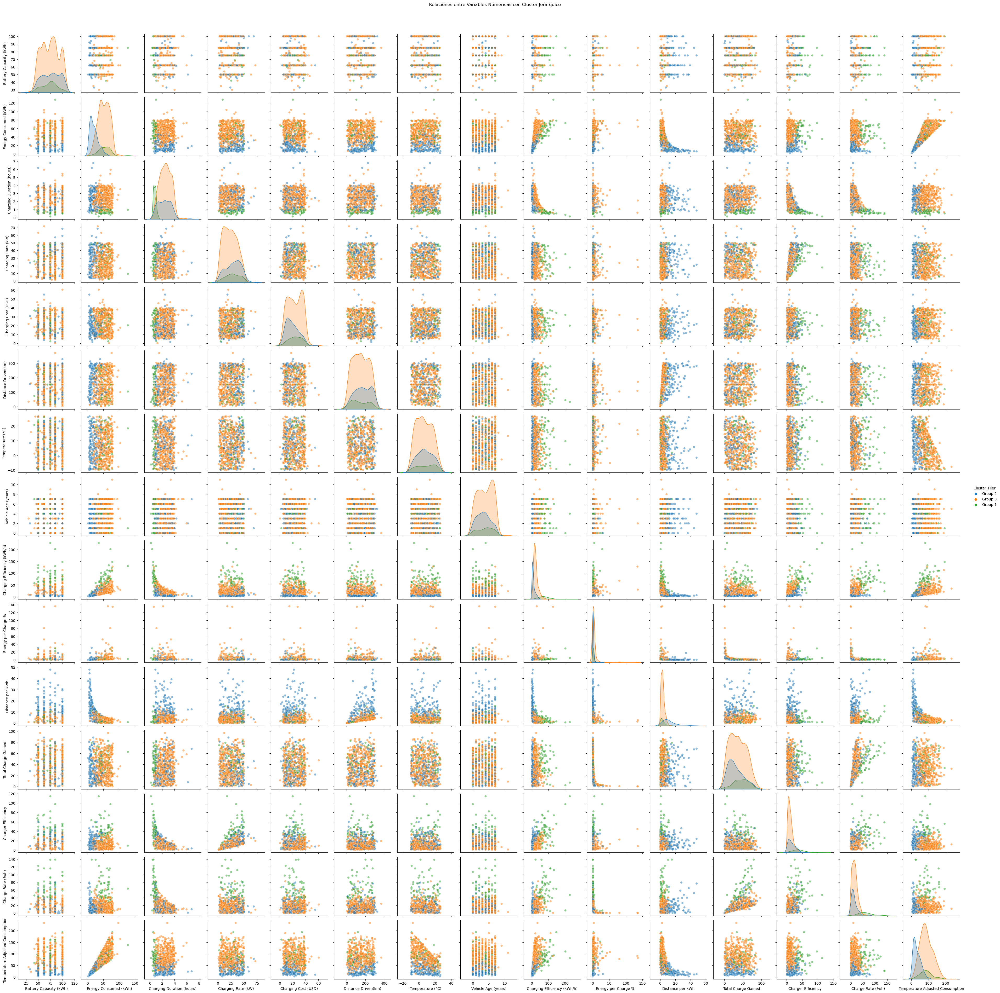

In [77]:
import seaborn as sns
import matplotlib.pyplot as plt

# Crear un gráfico de pares con una tercera feature representada por colores
plt.figure(figsize=(12, 12))
sns.pairplot(data_cleaned, diag_kind='kde', plot_kws={'alpha': 0.5}, hue='Cluster_Hier')

plt.suptitle("Relaciones entre Variables Numéricas con Cluster Jerárquico", y=1.02)

plt.show()


<Figure size 1200x1200 with 0 Axes>

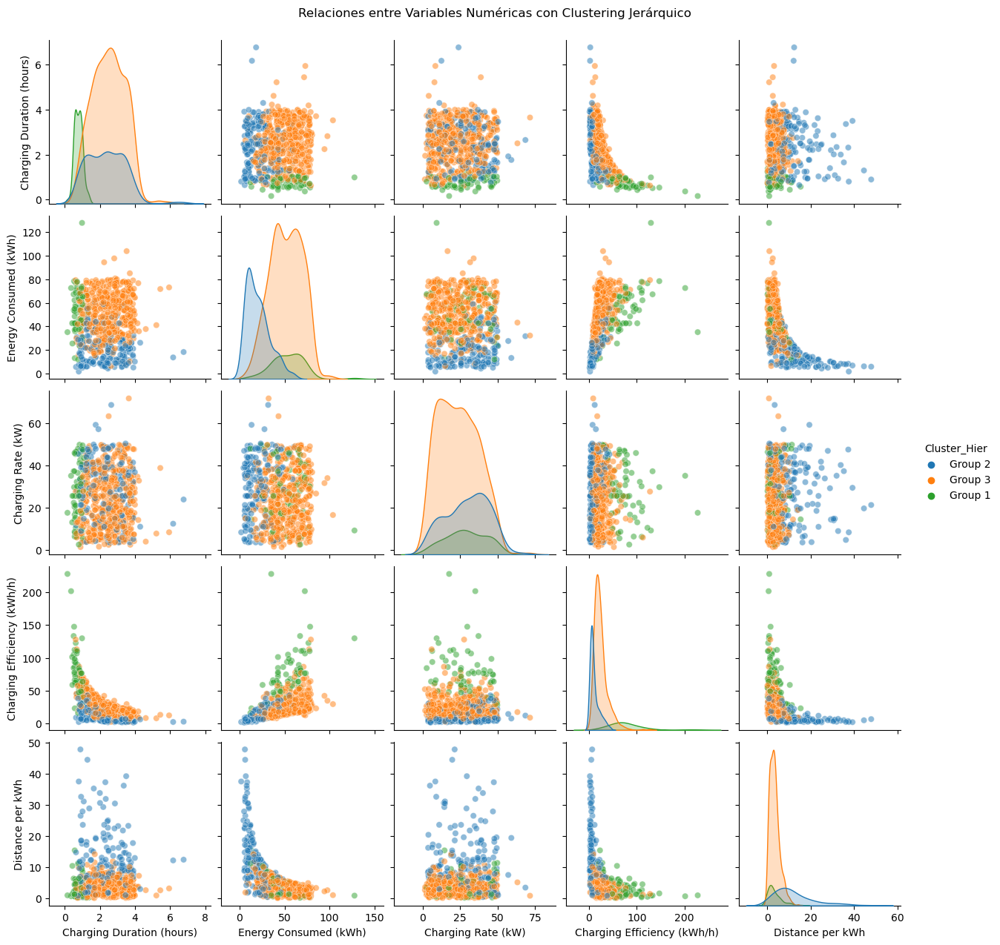

In [78]:
import seaborn as sns
import matplotlib.pyplot as plt

# Variables que quieres incluir en el pairplot
variables_seleccionadas = ['Charging Duration (hours)', 'Energy Consumed (kWh)', 'Charging Rate (kW)', 'Charging Efficiency (kWh/h)', 'Distance per kWh']  # Reemplaza con los nombres reales de las variables

# Crear un gráfico de pares con las variables seleccionadas
plt.figure(figsize=(12, 12))
sns.pairplot(data_cleaned, diag_kind='kde', plot_kws={'alpha': 0.5}, hue='Cluster_Hier', vars=variables_seleccionadas)

plt.suptitle("Relaciones entre Variables Numéricas con Clustering Jerárquico", y=1.02)

plt.show()

<Figure size 1200x1200 with 0 Axes>

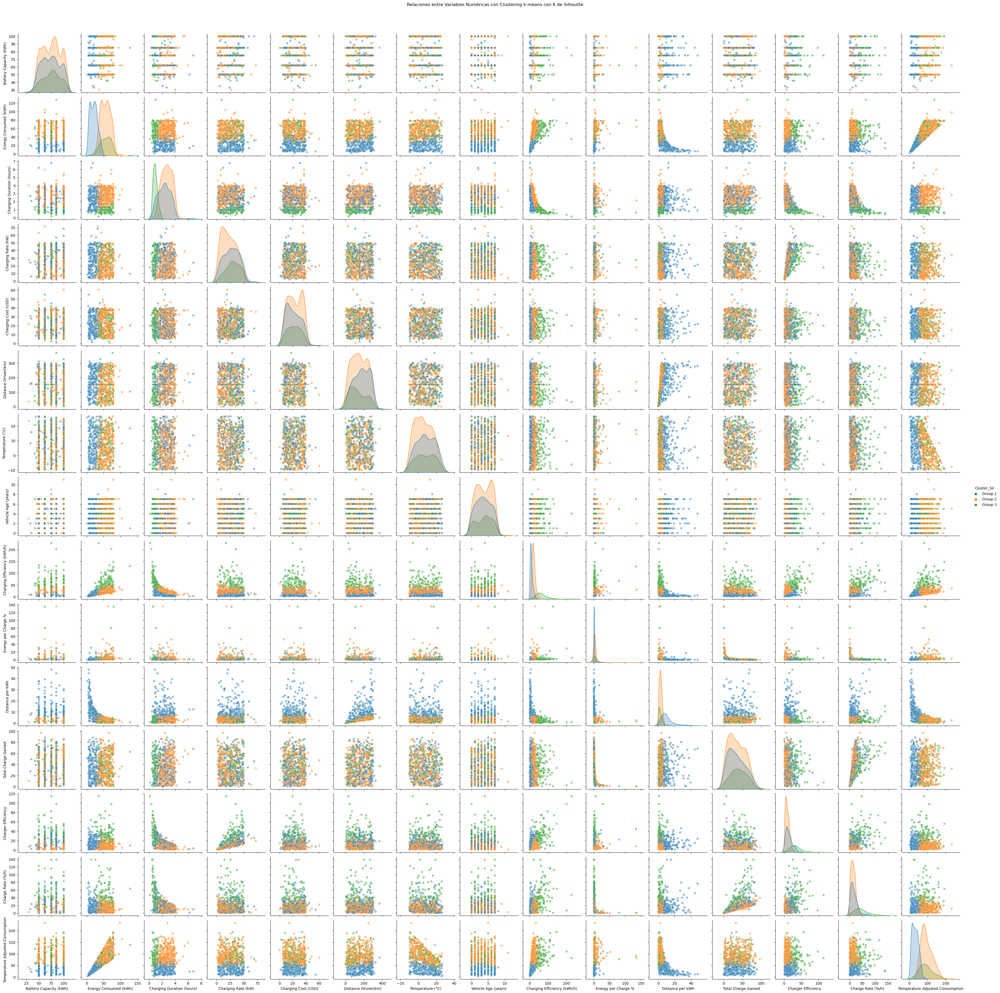

In [79]:
import seaborn as sns
import matplotlib.pyplot as plt

# Crear un gráfico de pares con una tercera feature representada por colores
plt.figure(figsize=(12, 12))
sns.pairplot(data_cleaned, diag_kind='kde', plot_kws={'alpha': 0.5}, hue='Cluster_Sil')

plt.suptitle("Relaciones entre Variables Numéricas con Clustering k-means con K de Silhoutte", y=1.02)

plt.show()


<Figure size 1200x1200 with 0 Axes>

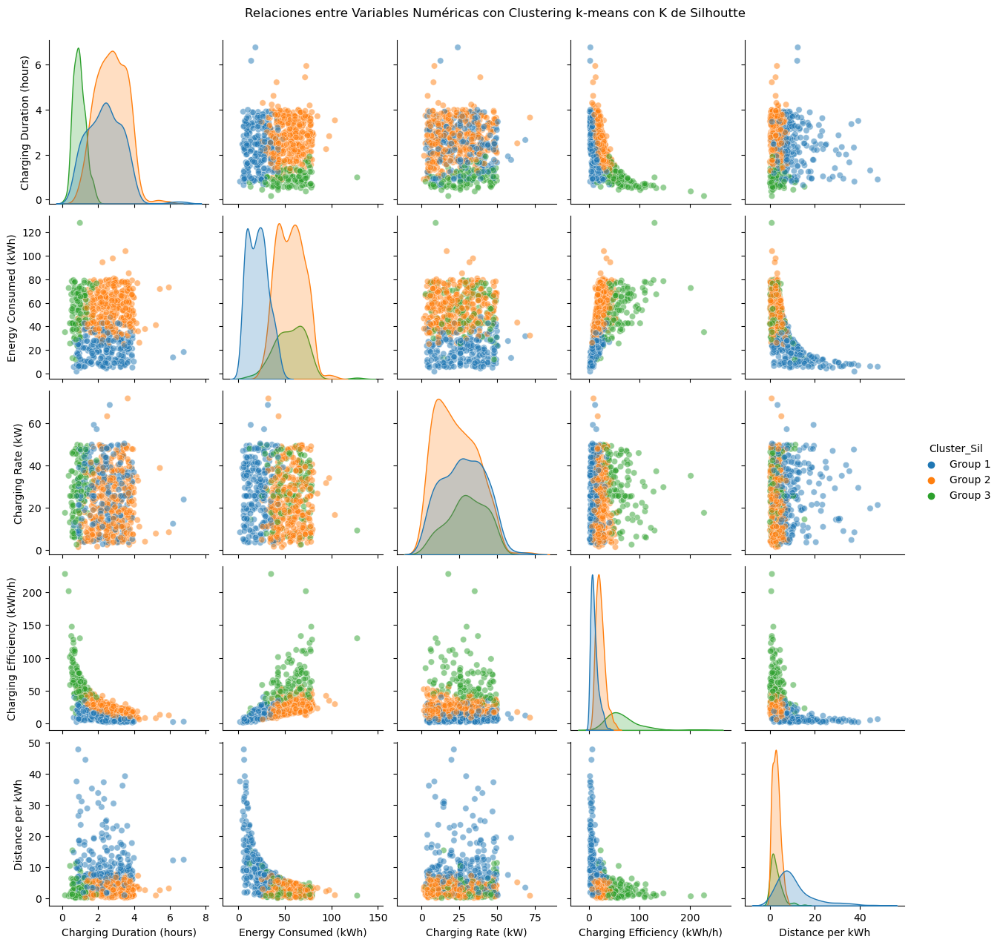

In [80]:
import seaborn as sns
import matplotlib.pyplot as plt

# Variables que quieres incluir en el pairplot
variables_seleccionadas = ['Charging Duration (hours)', 'Energy Consumed (kWh)', 'Charging Rate (kW)', 'Charging Efficiency (kWh/h)', 'Distance per kWh']  # Reemplaza con los nombres reales de las variables

# Crear un gráfico de pares con las variables seleccionadas
plt.figure(figsize=(12, 12))
sns.pairplot(data_cleaned, diag_kind='kde', plot_kws={'alpha': 0.5}, hue='Cluster_Sil', vars=variables_seleccionadas)

plt.suptitle("Relaciones entre Variables Numéricas con Clustering k-means con K de Silhoutte", y=1.02)

plt.show()

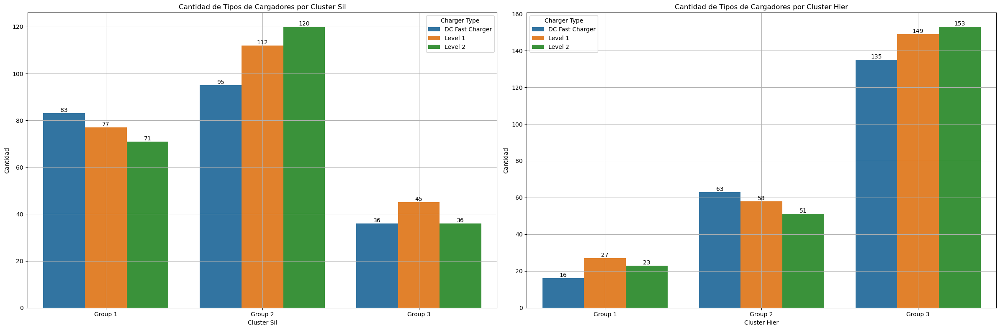

In [81]:
import seaborn as sns
import matplotlib.pyplot as plt

# Agrupar por 'Cluster_Sil' y 'Charger Type' y contar las ocurrencias
charger_counts_sil = data_cleaned.groupby(['Cluster_Sil', 'Charger Type']).size().reset_index(name='Count')

# Agrupar por 'Cluster_Hier' y 'Charger Type' y contar las ocurrencias
charger_counts_hier = data_cleaned.groupby(['Cluster_Hier', 'Charger Type']).size().reset_index(name='Count')

# Crear una figura con dos subplots
fig, axes = plt.subplots(1, 2, figsize=(24, 8))

# Gráfico de barras para 'Cluster_Sil'
barplot_sil = sns.barplot(
    data=charger_counts_sil,
    x='Cluster_Sil',
    y='Count',
    hue='Charger Type',
    ax=axes[0]
)

# Añadir números encima de cada barra para 'Cluster_Sil'
for bar in barplot_sil.patches:
    bar_height = bar.get_height()
    barplot_sil.text(
        x=bar.get_x() + bar.get_width() / 2, 
        y=bar_height, 
        s=int(bar_height),  # Convertir a entero si es necesario
        ha='center', 
        va='bottom'
    )

axes[0].set_title('Cantidad de Tipos de Cargadores por Cluster Sil')
axes[0].set_xlabel('Cluster Sil')
axes[0].set_ylabel('Cantidad')
axes[0].legend(title='Charger Type')
axes[0].grid(True)

# Gráfico de barras para 'Cluster_Hier'
barplot_hier = sns.barplot(
    data=charger_counts_hier,
    x='Cluster_Hier',
    y='Count',
    hue='Charger Type',
    ax=axes[1]
)

# Añadir números encima de cada barra para 'Cluster_Hier'
for bar in barplot_hier.patches:
    bar_height = bar.get_height()
    barplot_hier.text(
        x=bar.get_x() + bar.get_width() / 2, 
        y=bar_height, 
        s=int(bar_height),  # Convertir a entero si es necesario
        ha='center', 
        va='bottom'
    )

axes[1].set_title('Cantidad de Tipos de Cargadores por Cluster Hier')
axes[1].set_xlabel('Cluster Hier')
axes[1].set_ylabel('Cantidad')
axes[1].legend(title='Charger Type')
axes[1].grid(True)

# Mostrar la figura
plt.tight_layout()
plt.show()


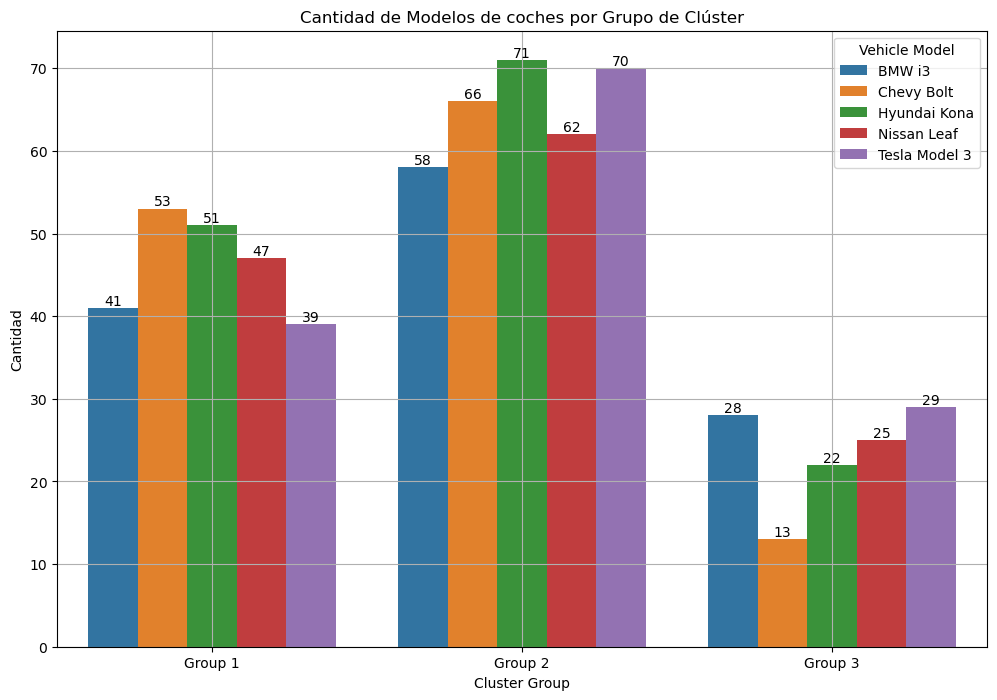

In [82]:


# Agrupar por 'Cluster' y 'Charger Type' y contar las ocurrencias
charger_counts = data_cleaned.groupby(['Cluster_Sil', 'Vehicle Model']).size().reset_index(name='Count')

# Crear un gráfico de barras
plt.figure(figsize=(12, 8))
barplot = sns.barplot(
    data=charger_counts,
    x='Cluster_Sil',
    y='Count',
    hue='Vehicle Model',
    #palette='tab10'
)

# Añadir números encima de cada barra
for bar in barplot.patches:
    bar_height = bar.get_height()
    barplot.text(
        x=bar.get_x() + bar.get_width() / 2, 
        y=bar_height, 
        s=int(bar_height),  # Convertir a entero si es necesario
        ha='center', 
        va='bottom'
    )

# Añadir etiquetas y título
plt.title('Cantidad de Modelos de coches por Grupo de Clúster')
plt.xlabel('Cluster Group')
plt.ylabel('Cantidad')
plt.legend(title='Vehicle Model')
plt.grid(True)
plt.show()


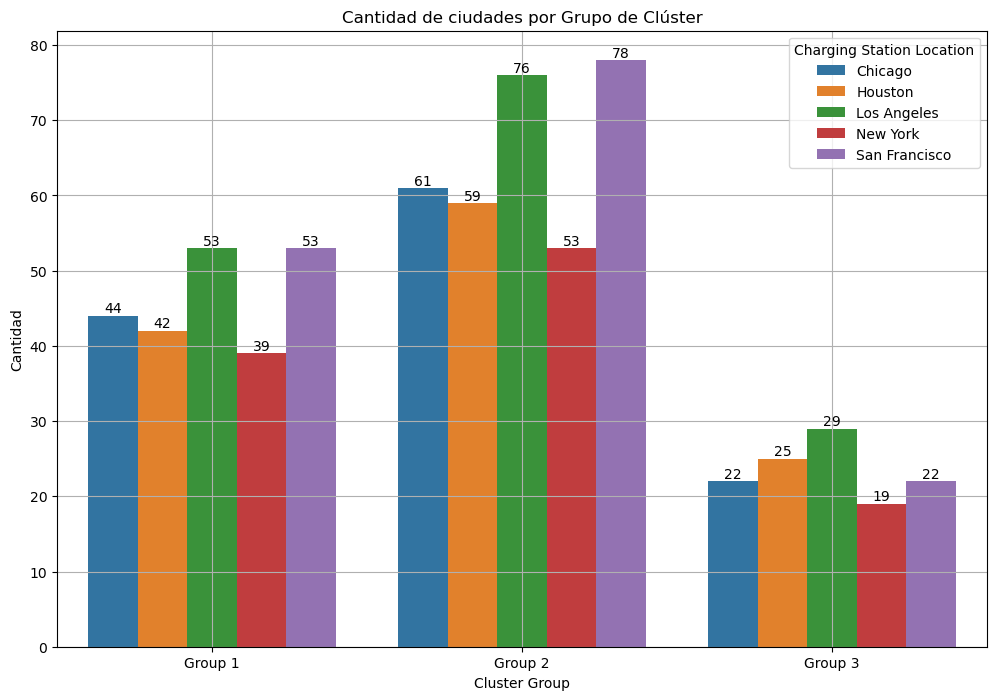

In [83]:
# Agrupar por 'Cluster' y 'Charger Type' y contar las ocurrencias
charger_counts = data_cleaned.groupby(['Cluster_Sil', 'Charging Station Location']).size().reset_index(name='Count')

# Crear un gráfico de barras
plt.figure(figsize=(12, 8))
barplot = sns.barplot(
    data=charger_counts,
    x='Cluster_Sil',
    y='Count',
    hue='Charging Station Location',
    #palette='tab10'
)

# Añadir números encima de cada barra
for bar in barplot.patches:
    bar_height = bar.get_height()
    barplot.text(
        x=bar.get_x() + bar.get_width() / 2, 
        y=bar_height, 
        s=int(bar_height),  # Convertir a entero si es necesario
        ha='center', 
        va='bottom'
    )

# Añadir etiquetas y título
plt.title('Cantidad de ciudades por Grupo de Clúster')
plt.xlabel('Cluster Group')
plt.ylabel('Cantidad')
plt.legend(title='Charging Station Location')
plt.grid(True)
plt.show()


In [84]:
# Seleccionar columnas numéricas y la columna 'Cluster_Sil'
data_for_clustering2 = data_cleaned.select_dtypes(include='number').copy()

# Asegurarse de incluir 'Cluster_Sil' si no es numérica y si existe
if 'Cluster_Sil' in data_cleaned.columns and data_cleaned['Cluster_Sil'].dtype != 'number':
    data_for_clustering2['Cluster_Sil'] = data_cleaned['Cluster_Sil']

# Calcular las medias de las variables en cada cluster
cluster_summary = data_for_clustering2.groupby('Cluster_Sil').mean()
#print(cluster_summary)

cluster_summary



,Battery Capacity (kWh),Energy Consumed (kWh),Charging Duration (hours),Charging Rate (kW),Charging Cost (USD),Distance Driven(km),Temperature (°C),Vehicle Age (years),Charging Efficiency (kWh/h),Energy per Charge %,Distance per kWh,Total Charge Gained,Charger Efficiency,Charge Rate (%/h),Temperature Adjusted Consumption
Cluster_Sil,,,,,,,,,,,,,,,
Group 1,74.051948,20.788074,2.365635,27.645061,21.225744,175.440331,8.264659,3.584416,10.483492,1.503170,10.972869,34.384071,14.093256,17.367166,32.863829
Group 2,74.911315,55.894804,2.735031,23.094107,23.372003,149.598372,5.687437,3.746177,22.462010,4.036976,2.803510,35.163406,9.049426,13.690062,95.434644
Group 3,75.555556,55.657832,0.944857,29.755609,21.901659,133.637925,7.816610,3.692308,65.997046,4.343061,2.797158,39.553666,34.313335,46.088178,91.367903


## Conclusiones:

Hemos observado teniendo en cuanta los resultados que el dataset parece ser haber sido generado de forma sintética y no con datos reales. En las siguientes líneas se verá con pruebas esta afirmación. Nos basamos para ello en que las temperaturas superan en mucho a las temperaturas medias e incluso máximas para cada ciudad (cuyas medidas reales han sido contrastadas con [https://meteostat.net/es/](https://meteostat.net/es/)). 

En un principio se sospecho que hubiese medidas mezcladas con diferentes unidades (ºC y ºF), y se construye una función para eliminar este problema como se puede ver en el código. Pero los datos no se correspondían con las curvas de temperaturas de dichas ciudades.

Bajo la sospecha de que los datos del dataset han sido generados y no recogidos se volvió a inspeccionar minuciosamente los datos en crudo, observando que la columna "Charging Start Time" sigue una distribución periódica, con hora exácta, de la cada carga en ciudades diferentes.

Las siguientes líneas de código destacan estos hechos:


Valores eliminados por la condición en Houston con Temp <= 24°C: 0 filas
Valores eliminados por la condición en Los Angeles con Temp <= 27°C: 0 filas
Valores eliminados por la condición en New York con Temp <= 20°C: 0 filas
Valores eliminados por la condición en San Francisco con Temp <= 27°C: 0 filas
Valores eliminados por la condición en Chicago con Temp <= 20°C: 0 filas


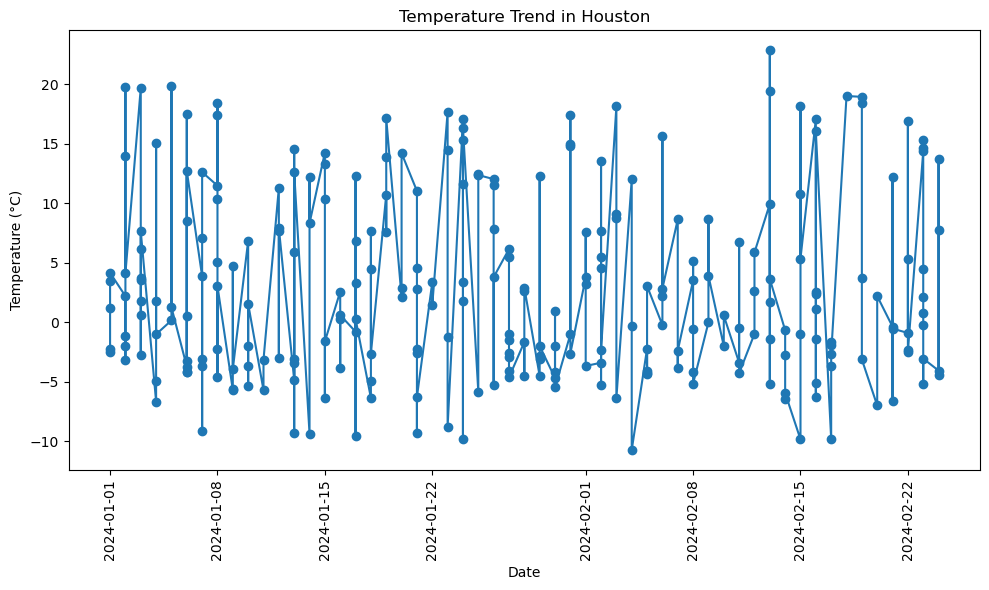

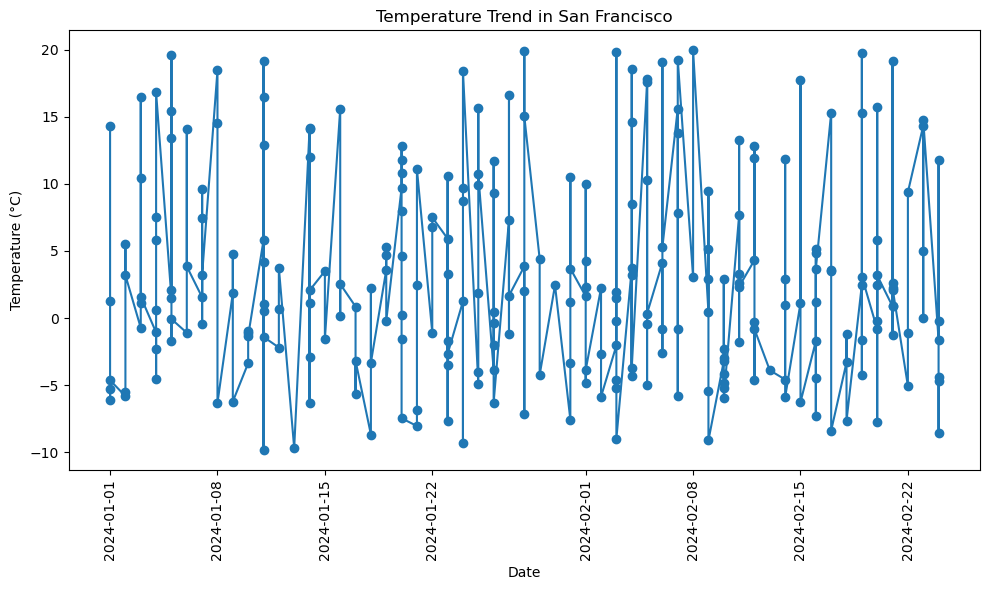

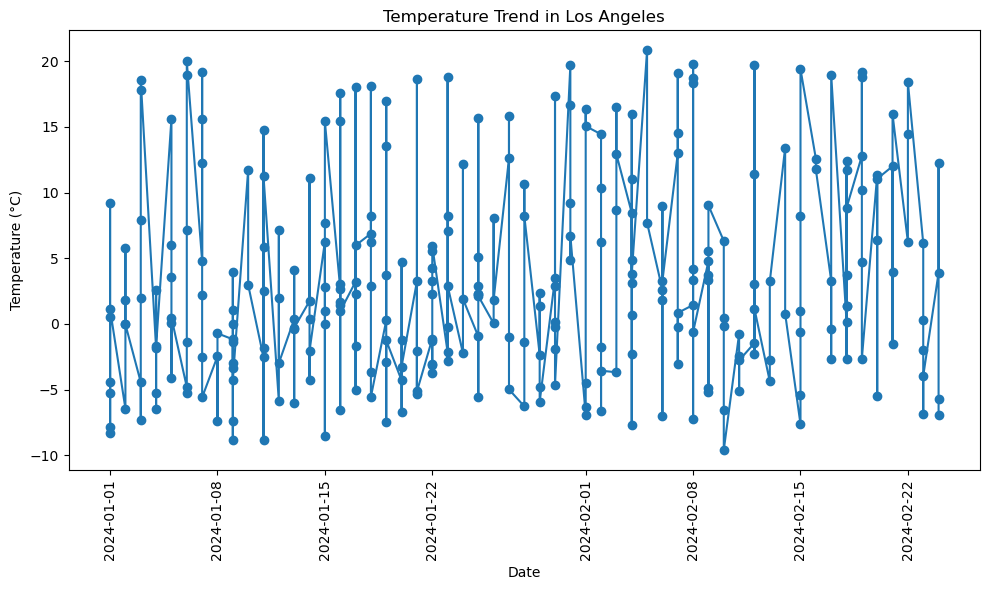

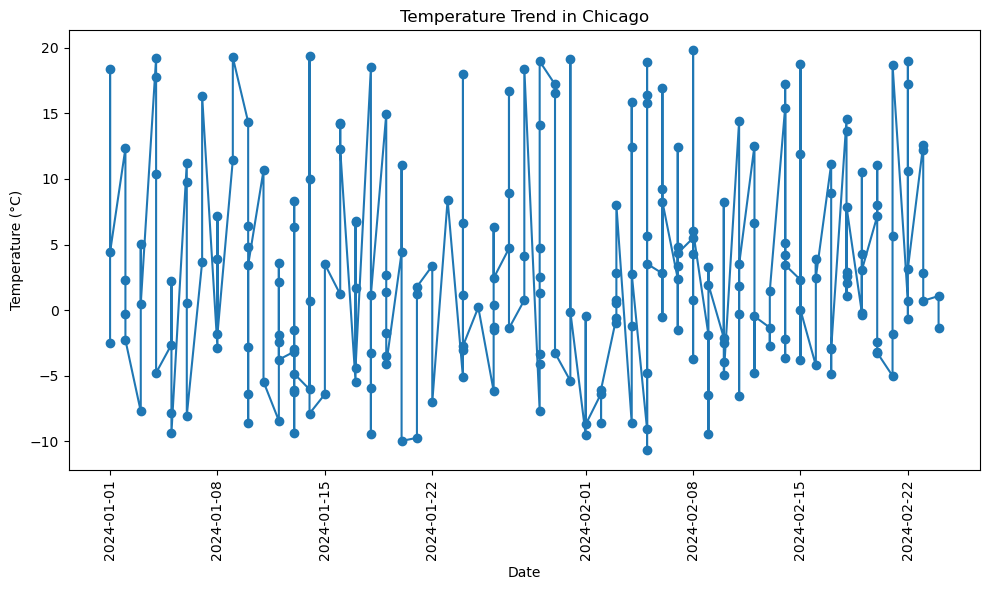

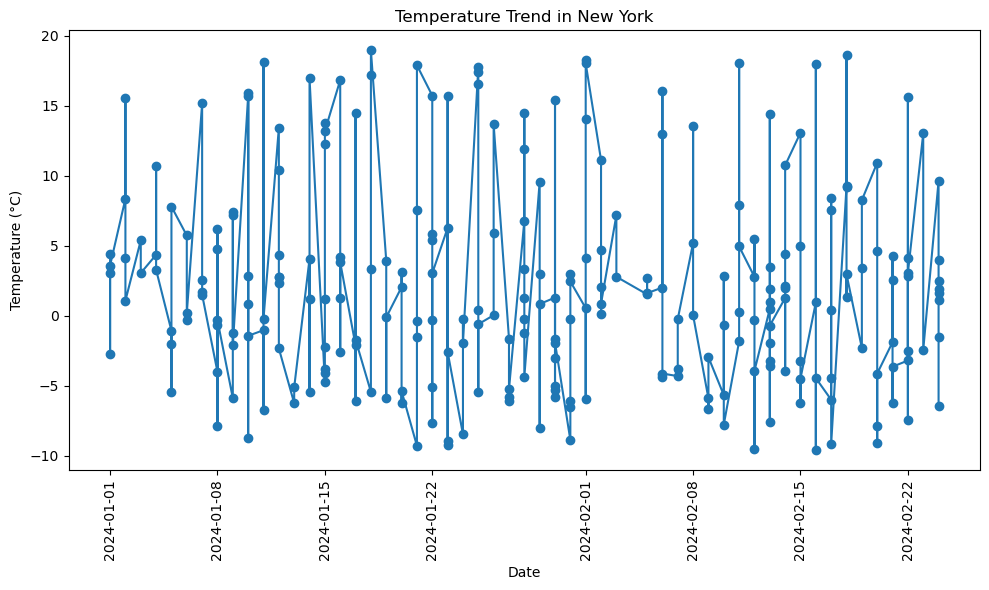

In [85]:
import matplotlib.pyplot as plt

# Convert the Charging Start Time to datetime and extract the date
data_temp = raw_data
data_temp['Charging Start Time'] = pd.to_datetime(data_temp['Charging Start Time'])
data_temp['Date'] = data_temp['Charging Start Time'].dt.date

def convert_to_celsius(temp):
    if temp > 20 or temp < -30:  # Assuming this range for temperatures in °C
        return (temp - 32) * 5/9
    return temp

# Apply the conversion
data_temp['Temperature (°C)'] = data_temp['Temperature (°C)'].apply(convert_to_celsius)

# Verify the conversion by checking the updated range
data_temp['Temperature (°C)'].describe()

# Temperaturas: 
ciudades_temp_max = {
    "Houston": 24,
    "Los Angeles": 27,
    "New York": 20,
    "San Francisco": 27,
    "Chicago": 20
}

# Iterar sobre cada ciudad y aplicar el filtro correspondiente
for ciudad, temp_max in ciudades_temp_max.items():
    # Contar las filas eliminadas antes de aplicar el filtro
    filas_eliminadas = len(data_temp[~((data_temp['Charging Station Location'] != ciudad) | ((data_temp['Charging Station Location'] == ciudad)  & (data_temp['Temperature (°C)'] <= temp_max)))])
    print(f"Valores eliminados por la condición en {ciudad} con Temp <= {temp_max}°C: {filas_eliminadas} filas")
    # Aplicar el filtro
    data_temp = data_temp[((data_temp['Charging Station Location'] != ciudad) | ((data_temp['Charging Station Location'] == ciudad) & (data_temp['Temperature (°C)'] <= temp_max)))]


# Identify unique cities
unique_cities = raw_data['Charging Station Location'].unique()

# Create a plot for each city
for city in unique_cities:
    city_data = data_temp[data_temp['Charging Station Location'] == city]
    plt.figure(figsize=(10, 6))
    plt.plot(city_data['Date'], city_data['Temperature (°C)'], marker='o', linestyle='-')
    plt.title(f'Temperature Trend in {city}')
    plt.xlabel('Date')
    plt.ylabel('Temperature (°C)')
    plt.xticks(rotation=90)
    plt.tight_layout()
    plt.show()


### Descripción de Clusters

1. **Group 1**:
   - **Alta eficiencia energética**: Mayor distancia por carga (175.44 km) y menor impacto de la temperatura en el consumo.
   - **Moderado consumo de energía**: 20.79 kWh en promedio.

2. **Group 2**:
   - **Alto consumo de energía**: 55.89 kWh y mayor sensibilidad a la temperatura.
   - **Eficiencia baja**: Distancia por kWh de 2.80 km.

3. **Group 3**:
   - **Carga rápida y eficiente**: Menor tiempo de carga (0.94 horas) y alta eficiencia del cargador (34.31).
   - **Alta tasa de carga**: 29.76 kW.


## Anotaciones del trabajo:



tenemos 1320 filas y 20 columnas

* Columnas a borrar en el dataset:
    - User ID
    - Charging Start Time
    - Charging End Time



Preguntas:

- ¿Cuáles son las principales variables que influyen en el tiempo total de carga?


Gráficas sencillas:

- Picos de carga agrupados en momento de día y día: 7*4= 28 momentos
- Matriz de relaciones que influye más en la duración de la carga o en el coste. (solo datos numericos).

Preguntas sacadas de internet (Jaime):

* Análisis de comportamiento de carga:

¿Cuál es la variación del tiempo de carga en función de diferentes horas del día o días de la semana?
¿Existe una relación entre el tiempo de carga y la tarifa de energía en distintas estaciones o franjas horarias?
¿Se observan patrones estacionales en el uso de estaciones de carga (por ejemplo, diferencias entre invierno y verano)?

* Segmentación de usuarios y patrones de uso:

¿Existen diferentes perfiles de usuarios (según tiempo medio de carga, frecuencia de uso, etc.) y cómo varían sus comportamientos?
¿Qué diferencias existen en los patrones de carga entre usuarios particulares y comerciales, si el dataset contiene esta información?
¿Qué factores parecen influir más en la elección de una estación de carga específica?

* Predicción y optimización:

¿Qué variables tienen el mayor impacto en la duración del tiempo de carga y en la frecuencia de uso de las estaciones?
¿Es posible predecir las horas pico de uso en función de los datos históricos?
¿Qué características del punto de carga (como potencia, ubicación) predicen un mayor número de usuarios?

* Impacto en la infraestructura de carga:

¿Cuáles son los puntos de carga con mayor uso, y qué características tienen en común?
¿Cómo varía la demanda de carga según la proximidad a áreas urbanas o rurales?
¿Existen patrones de uso que sugieren la necesidad de ampliar la infraestructura en ciertas áreas?

* Sostenibilidad y Eficiencia Energética:

¿Cuánto tiempo, en promedio, permanecen los vehículos conectados después de estar completamente cargados?
¿Cuál es la tasa de eficiencia en el uso de las estaciones de carga? ¿Se producen períodos significativos de inactividad?
¿Cómo afecta el tiempo de conexión a la eficiencia de la infraestructura de carga en general?

* Tendencias de adopción de EV:

¿Se observa un crecimiento en la cantidad de sesiones de carga a lo largo del tiempo? ¿Es consistente en todas las estaciones?
¿Qué patrones emergentes indican un aumento en la adopción de vehículos eléctricos en ciertas áreas o tipos de usuarios?

Posibles Preguntas de Análisis (Luis)
* Patrones de Consumo y Eficiencia:
-¿Cuál es la relación entre el Estado de Carga al inicio y final y la Energía Consumida?
-¿Cómo varía el Costo de Carga en función del Ubicación de la Estación o el Tipo de Cargador?

* Factores que Afectan la Duración y Costo de la Carga:
¿Cómo influyen el Modelo de Vehículo, la Capacidad de Batería y la Edad del Vehículo en el Costo de Carga y el Tiempo de Carga?
¿Qué impacto tiene la Temperatura en la Duración de Carga y Eficiencia?

* Análisis de Uso del Cargador por Tipo de Usuario:
¿Qué diferencias existen entre los patrones de carga de los usuarios clasificados como Commuters frente a los Long-Distance Travelers?
¿Existe una tendencia en el Horario de Carga según el Tipo de Usuario?

* Análisis de Localización y Estaciones de Carga:
¿Cuáles son los lugares con mayor consumo de energía, y cómo varía el Tiempo de Carga entre distintas Ubicaciones?
¿Se identifican patrones de alta demanda según el Día de la Semana o la Hora del Día?


# Anotaciones para la presentación:

- Decir algunas de las preguntas que podíamos hacernos o intentar predecir y porque finalmente nos quedamos con el time duration. (Otras opciones el coste de cargar el coche).
- Decir porque hemos quitado ciertas características del dataset.
- Decir porque hemos añadido otras características.